In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
from memflow.read_data.dataset_all import DatasetCombined
from memflow.unfolding_network.conditional_transformer import ConditioningTransformerLayer
from memflow.unfolding_flow.utils import *
from memflow.unfolding_flow.unfolding_flow import UnfoldingFlow

import numpy as np
#import scipy.stats as st
from torch import optim
from torch.utils.data import DataLoader
import torch.nn as nn
from torch.nn.functional import normalize
from torch.optim.lr_scheduler import CosineAnnealingLR

import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import matplotlib as mpl
from matplotlib import cm

from collections import defaultdict
from tensorboardX import SummaryWriter
from omegaconf import OmegaConf
import sys
import argparse
from pynvml import *
from hist import Hist
import hist
import vector
import mplhep
import awkward as ak
import random
import pandas as pd

from memflow.read_data.utils import to_flat_tensor
from memflow.phasespace.phasespace import PhaseSpace

from utils import FindMasks
from utils import SavePlots
from utils import plot_regressionFactor, plot_diff_mode_quantile,get_central_smallest_interval


from rich.progress import track

pi = torch.pi


In [2]:
torch.cuda.device_count()

1

In [3]:
torch.cuda.empty_cache()

In [4]:
batchSize = 1024

device = torch.device("cuda") #torch.device("cuda" if torch.cuda.is_available() else "cpu") # specify the GPU ids

basedir_flow= "/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/flow_flow_sampling_v3c-sampling_DiagNormal_NoTransf6_NoBins40_DNN2_512/"

model_weights = basedir_flow + '/model_flow_sampling_v3c-sampling.pt'

path_to_conf = basedir_flow + '/config_flow_sampling_v3c-sampling.yaml'

input_dataset_test = '/work/dvalsecc/MEM/datasets/all_jets_fullRun2_ttHbb_forTraining_allyears_spanetprov_part2.parquet'

with open(path_to_conf) as f:
        config = OmegaConf.load(path_to_conf)

config

data = DatasetCombined(input_dataset_test, dev=torch.device("cpu"),
                                    dtype=torch.float64, datasets=['partons_lab', 'reco_lab', 'partons_CM'],
                           reco_list_lab=['scaledLogRecoParticles', 'mask_lepton', 
                                      'mask_jets','mask_met',
                                      'mask_boost', 'scaledLogBoost'],
                           parton_list_lab=['logScaled_data_higgs_t_tbar_ISR',
                                        'logScaled_data_boost',
                                        'mean_log_data_higgs_t_tbar_ISR',
                                        'std_log_data_higgs_t_tbar_ISR',
                                        'mean_log_data_boost',
                                            'std_log_data_boost'],
                           parton_list_cm=['phasespace_intermediateParticles_onShell_logit',
                                           'phasespace_intermediateParticles_onShell_logit_scaled',
                                           'phasespace_intermediateParticles_onShell',
                                           'mean_phasespace_intermediateParticles_onShell_logit',
                                            'std_phasespace_intermediateParticles_onShell_logit',
                                           'mean_log_data_higgs_t_tbar_ISR',
                                        'std_log_data_higgs_t_tbar_ISR',
                                          ])



log_mean_parton_lab = data.partons_lab.mean_log_data_higgs_t_tbar_ISR.to(device)
log_std_parton_lab = data.partons_lab.std_log_data_higgs_t_tbar_ISR.to(device)
log_mean_parton_CM = data.partons_CM.mean_log_data_higgs_t_tbar_ISR.to(device)
log_std_parton_CM = data.partons_CM.std_log_data_higgs_t_tbar_ISR.to(device)
log_mean_boost = data.partons_lab.mean_log_data_boost.to(device)
log_std_boost = data.partons_lab.std_log_data_boost.to(device)
mean_ps = data.partons_CM.mean_phasespace_intermediateParticles_onShell_logit.to(device)
scale_ps = data.partons_CM.std_phasespace_intermediateParticles_onShell_logit.to(device)

# Initialize model
model = UnfoldingFlow(
                pretrained_model=None,
                load_conditioning_model=False,
                scaling_partons_lab = [log_mean_parton_lab, log_std_parton_lab],
                scaling_boost_lab = [log_mean_boost, log_std_boost],
                scaling_partons_CM_ps = [mean_ps, scale_ps],

                no_jets=config.input_shape.number_jets,
                no_lept=config.input_shape.number_lept,
                input_features=config.input_shape.input_features,
                cond_hiddenFeatures=config.conditioning_transformer.hidden_features,
                cond_dimFeedForward=config.conditioning_transformer.dim_feedforward_transformer,
                cond_outFeatures=config.conditioning_transformer.out_features,
                cond_nheadEncoder=config.conditioning_transformer.nhead_encoder,
                cond_NoLayersEncoder=config.conditioning_transformer.no_layers_encoder,
                cond_nheadDecoder=config.conditioning_transformer.nhead_decoder,
                cond_NoLayersDecoder=config.conditioning_transformer.no_layers_decoder,
                cond_NoDecoders=config.conditioning_transformer.no_decoders,
                cond_aggregate=config.conditioning_transformer.aggregate,
                cond_use_latent=config.conditioning_transformer.use_latent,
                cond_out_features_latent=config.conditioning_transformer.out_features_latent,
                cond_no_layers_decoder_latent=config.conditioning_transformer.no_layers_decoder_latent,   
    
                flow_nfeatures=config.unfolding_flow.nfeatures,
                flow_ncond=config.unfolding_flow.ncond, 
                flow_ntransforms=config.unfolding_flow.ntransforms,
                flow_hiddenMLP_NoLayers=config.unfolding_flow.hiddenMLP_NoLayers, 
                flow_hiddenMLP_LayerDim=config.unfolding_flow.hiddenMLP_LayerDim,
                flow_bins=config.unfolding_flow.bins,
                flow_autoregressive=config.unfolding_flow.autoregressive,
                flow_base=config.unfolding_flow.base,
                flow_base_first_arg=config.unfolding_flow.base_first_arg,
                flow_base_second_arg=config.unfolding_flow.base_second_arg,
                flow_bound=config.unfolding_flow.bound,
                randPerm=config.unfolding_flow.randPerm,
                device=device,
                dtype=torch.float64,
                eps=config.training_params.eps)

model.load_state_dict(torch.load(model_weights, map_location=device)["model_state_dict"])


>>Loading datasets
Loading partons in LAB
PartonLevel LAB
Reading parton_level Files
Load logScaled_data_higgs_t_tbar_ISR
Load logScaled_data_boost
Parton: Move tensors to device (cpu) memory
Loading reco in LAB
RecoLevel LAB
Reading reco_level Files
Load scaledLogBoost
Load scaledLogRecoParticles
Reco: Move tensors to device (cpu) memory
Loading partons in CM
PartonLevel CM
Reading parton_level Files
Load phasespace_intermediateParticles_onShell
Load phasespace_intermediateParticles_onShell_logit
Load logScaled_data_higgs_t_tbar_ISR
Parton: Move tensors to device (cpu) memory
Loaded datasets:  ['partons_lab', 'reco_lab', 'partons_CM']


<All keys matched successfully>

In [5]:
E_CM = 13000
phasespace = PhaseSpace(E_CM, [21,21], [25,6,-6,21], dev="cpu")


dataCM = data.partons_CM.data_higgs_t_tbar_ISR_cartesian
dataLab = data.partons_lab.data_higgs_t_tbar_ISR_cartesian
PS_target = data.partons_CM.phasespace_intermediateParticles_onShell
boost_parton = data.partons_CM.data_boost

higgsCorrect = vector.array(
    {
        "E": dataCM[:,0,0].detach().cpu().numpy(),
        "px": dataCM[:,0,1].detach().cpu().numpy(),
        "py": dataCM[:,0,2].detach().cpu().numpy(),
        "pz": dataCM[:,0,3].detach().cpu().numpy(),
    }
)

thadCorrect = vector.array(
    {
        "E": dataCM[:,1,0].detach().cpu().numpy(),
        "px": dataCM[:,1,1].detach().cpu().numpy(),
        "py": dataCM[:,1,2].detach().cpu().numpy(),
        "pz": dataCM[:,1,3].detach().cpu().numpy(),
    }
)

tlepCorrect = vector.array(
    {
        "E": dataCM[:,2,0].detach().cpu().numpy(),
        "px": dataCM[:,2,1].detach().cpu().numpy(),
        "py": dataCM[:,2,2].detach().cpu().numpy(),
        "pz": dataCM[:,2,3].detach().cpu().numpy(),
    }
)

glISRCorrect = vector.array(
    {
        "E": dataCM[:,3,0].detach().cpu().numpy(),
        "px": dataCM[:,3,1].detach().cpu().numpy(),
        "py": dataCM[:,3,2].detach().cpu().numpy(),
        "pz": dataCM[:,3,3].detach().cpu().numpy(),
    }
)

# In the lab
higgsCorrect_lab = vector.array(
    {
        "E": dataLab[:,0,0].detach().cpu().numpy(),
        "px": dataLab[:,0,1].detach().cpu().numpy(),
        "py": dataLab[:,0,2].detach().cpu().numpy(),
        "pz": dataLab[:,0,3].detach().cpu().numpy(),
    }
)

thadCorrect_lab = vector.array(
    {
        "E": dataLab[:,1,0].detach().cpu().numpy(),
        "px": dataLab[:,1,1].detach().cpu().numpy(),
        "py": dataLab[:,1,2].detach().cpu().numpy(),
        "pz": dataLab[:,1,3].detach().cpu().numpy(),
    }
)

tlepCorrect_lab = vector.array(
    {
        "E": dataLab[:,2,0].detach().cpu().numpy(),
        "px": dataLab[:,2,1].detach().cpu().numpy(),
        "py": dataLab[:,2,2].detach().cpu().numpy(),
        "pz": dataLab[:,2,3].detach().cpu().numpy(),
    }
)

glISRCorrect_lab = vector.array(
    {
        "E": dataLab[:,3,0].detach().cpu().numpy(),
        "px": dataLab[:,3,1].detach().cpu().numpy(),
        "py": dataLab[:,3,2].detach().cpu().numpy(),
        "pz": dataLab[:,3,3].detach().cpu().numpy(),
    }
)

higgsCorrect = ak.with_name(higgsCorrect, name="Momentum4D")
thadCorrect = ak.with_name(thadCorrect, name="Momentum4D")
tlepCorrect = ak.with_name(tlepCorrect, name="Momentum4D")
glISRCorrect = ak.with_name(glISRCorrect, name="Momentum4D")

higgsCorrect_lab = ak.with_name(higgsCorrect_lab, name="Momentum4D")
thadCorrect_lab = ak.with_name(thadCorrect_lab, name="Momentum4D")
tlepCorrect_lab = ak.with_name(tlepCorrect_lab, name="Momentum4D")
glISRCorrect_lab = ak.with_name(glISRCorrect_lab, name="Momentum4D")

In [6]:
def plot_var2d(higgs_var1, higgs_var2, thad_var1, thad_var2, tlep_var1, tlep_var2,
             ISR_var1, ISR_var2, name1, name2, nameFig, start1=0, stop1=1000, start2=0, stop2=1000, bins1=100, bins2=100,
             higgs_mask=1, thad_mask=1, tlep_mask=1, ISR_mask=1, neg_Mask=False, log=False, name='da', nameunit=''):
        
        
        if neg_Mask:
            higgs_mask = np.logical_not(higgs_mask)
            thad_mask = np.logical_not(thad_mask)
            tlep_mask = np.logical_not(tlep_mask)
            ISR_mask = np.logical_not(ISR_mask)

        # Quick construction, no other imports needed:
        hist2d_var_higgs = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_thad = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_tlep = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_ISR = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_higgs.fill(higgs_var1[higgs_mask],
                            higgs_var2[higgs_mask])

        hist2d_var_thad.fill(thad_var1[thad_mask],
                            thad_var2[thad_mask])

        hist2d_var_tlep.fill(tlep_var1[tlep_mask],
                            tlep_var2[tlep_mask])

        hist2d_var_ISR.fill(ISR_var1[ISR_mask],
                            ISR_var2[ISR_mask])

        colormap='viridis'
        my_viridis = mpl.colormaps[colormap].with_extremes(under="white")
        
        fontsize = 20
        labelsize=14
        labels = ['higgs', 'thad', 'tlep', 'ISR']
        hist2d_list = [hist2d_var_higgs, hist2d_var_thad, hist2d_var_tlep, hist2d_var_ISR]
        
        
        fig, axs = plt.subplots(1, 4, figsize=(16, 6))

        if log:
            for i in range(4):
                w, x, y = hist2d_list[i].to_numpy()
                mesh = axs[i].pcolormesh(x, y, w.T, cmap=my_viridis, norm=mpl.colors.LogNorm(vmin=1))
                axs[i].set_xlabel(f"{name}-correct {nameunit}", fontsize=fontsize)
                axs[i].set_ylabel(f"{name}-regressed {nameunit}", fontsize=fontsize)
                axs[i].set_title(f"{labels[i]}", fontsize=fontsize)
                axs[i].tick_params(axis='both', which='major', labelsize=labelsize)
                cbar = fig.colorbar(mesh)
                cbar.ax.tick_params(labelsize=labelsize)
                plt.tight_layout()

        else:
            for i in range(4):
                w, x, y = hist2d_list[i].to_numpy()
                mesh = axs[i].pcolormesh(x, y, w.T, cmap=my_viridis, vmin=1)
                axs[i].set_xlabel(f"{name}-correct {nameunit}", fontsize=fontsize)
                axs[i].set_ylabel(f"{name}-regressed {nameunit}", fontsize=fontsize)
                axs[i].set_title(f"{labels[i]}", fontsize=fontsize)
                axs[i].tick_params(axis='both', which='major', labelsize=labelsize)
                cbar = fig.colorbar(mesh)
                cbar.ax.tick_params(labelsize=labelsize)
                plt.tight_layout()

In [7]:
def get_particle_awkward(momenta):
    
    higgs = momenta[:,0]
    thad = momenta[:,1]
    tlep = momenta[:,2]
    ISR = momenta[:,3]
    
    higgs = vector.array(
                {
                "E": higgs[:,0].detach().numpy(),
                "px": higgs[:,1].detach().numpy(),
                "py": higgs[:,2].detach().numpy(),
                "pz": higgs[:,3].detach().numpy()
                }
            )
    thad = vector.array(
                {
                "E": thad[:,0].detach().numpy(),
                "px": thad[:,1].detach().numpy(),
                "py": thad[:,2].detach().numpy(),
                "pz":thad[:,3].detach().numpy(),
                }
            )

    tlep = vector.array(
                {
                "E": tlep[:,0].detach().numpy(),
                "px": tlep[:,1].detach().numpy(),
                "py": tlep[:,2].detach().numpy(),
                "pz": tlep[:,3].detach().numpy(),
                }
            )
    
    ISR = vector.array(
                {
                "E": ISR[:,0].detach().numpy(),
                "px": ISR[:,1].detach().numpy(),
                "py": ISR[:,2].detach().numpy(),
                "pz": ISR[:,3].detach().numpy(),
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR


def get_particle_awkward_ptetaphi(momenta):
    
    higgs = momenta[:,0]
    thad = momenta[:,1]
    tlep = momenta[:,2]
    ISR = momenta[:,3]
    M_HIGGS = 125.25
    M_TOP = 172.5
    M_GLUON = 1e-5
    
    higgs = vector.array(
                {
                "pt": higgs[:,0].detach().numpy(),
                "eta": higgs[:,1].detach().numpy(),
                "phi": higgs[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_HIGGS
                }
            )
    thad = vector.array(
                {
                "pt": thad[:,0].detach().numpy(),
                "eta": thad[:,1].detach().numpy(),
                "phi": thad[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_TOP
                }
            )

    tlep = vector.array(
                {
                "pt": tlep[:,0].detach().numpy(),
                "eta": tlep[:,1].detach().numpy(),
                "phi": tlep[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_TOP
                }
            )
    
    ISR = vector.array(
                {
                "pt": ISR[:,0].detach().numpy(),
                "eta": ISR[:,1].detach().numpy(),
                "phi": ISR[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_GLUON
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR

def get_particle_awkward_samples(momenta):
    
    higgs = momenta[:,:,2]
    thad = momenta[:,:,3]
    tlep = momenta[:,:,4]
    ISR = momenta[:,:,5]
    
    higgs = vector.array(
                {
                "E": higgs[:,:,0].detach().numpy(),
                "px": higgs[:,:,1].detach().numpy(),
                "py": higgs[:,:,2].detach().numpy(),
                "pz": higgs[:,:,3].detach().numpy()
                }
            )

    thad = vector.array(
                {
                "E": thad[:,:,0].detach().numpy(),
                "px": thad[:,:,1].detach().numpy(),
                "py": thad[:,:,2].detach().numpy(),
                "pz":thad[:,:,3].detach().numpy(),
                }
            )

    tlep = vector.array(
                {
                "E": tlep[:,:,0].detach().numpy(),
                "px": tlep[:,:,1].detach().numpy(),
                "py": tlep[:,:,2].detach().numpy(),
                "pz": tlep[:,:,3].detach().numpy(),
                }
            )
    
    ISR = vector.array(
                {
                "E": ISR[:,:,0].detach().numpy(),
                "px": ISR[:,:,1].detach().numpy(),
                "py": ISR[:,:,2].detach().numpy(),
                "pz": ISR[:,:,3].detach().numpy(),
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR



def get_diff(C, C_samples, Nsamples):
    # Diff between target quantity in awkward array and samples of the same quantity
    return torch.from_numpy(ak.to_numpy(C_samples)) - torch.from_numpy(ak.to_numpy(C)).unsqueeze(1).expand(-1, Nsamples)

def get_std(C_samples): 
    return np.nanstd(ak.to_numpy(C_samples), axis=1)

# Testing the model sampling

In [61]:
indices = list(range(10))

In [62]:
logScaled_reco = data.reco_lab.scaledLogRecoParticles[indices].to(device)
mask_lepton_reco = data.reco_lab.mask_lepton[indices].to(device)
mask_jets = data.reco_lab.mask_jets[indices].to(device)
mask_met = data.reco_lab.mask_met[indices].to(device)
mask_boost_reco = data.reco_lab.mask_boost[indices].to(device)
data_boost_reco = data.reco_lab.scaledLogBoost[indices].to(device)

boost_parton = data.partons_CM.data_boost[indices].to(device)
parton_cartesian = data.partons_CM.data_higgs_t_tbar_ISR_cartesian_onShell[indices].to(device)
ps_target_scaled = data.partons_CM.phasespace_intermediateParticles_onShell_logit_scaled[indices].to(device)
ps_target = data.partons_CM.phasespace_intermediateParticles_onShell[indices].to(device)
ps_target_logit = data.partons_CM.phasespace_intermediateParticles_onShell[indices].to(device)

In [63]:
model = model.to(device)

In [64]:
device

device(type='cuda')

In [65]:
mask_recoParticles = torch.cat((mask_jets, mask_lepton_reco, mask_met), dim=1)
if True : # Always remove true proveance TODO REMOVE THE HACK 
    logScaled_reco = logScaled_reco[:,:,:-1]


In [66]:
with torch.no_grad():
# The provenance is remove in the model
    (data_regressed, data_regressed_cm, ps_regr,
         logit_ps_regr, flow_cond_vector,
         _, mask_problematic)   = model(logScaled_reco,
                                                  data_boost_reco,
                                                  mask_recoParticles,
                                                  mask_boost_reco,
                                                  None,
                                                  disableGradConditioning=False,
                                                  flow_eval="conditioning_only")


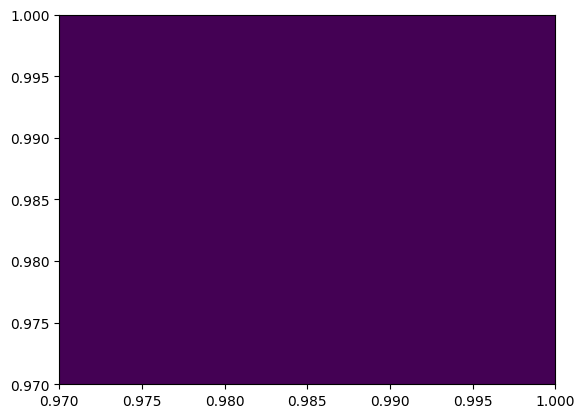

In [67]:
plt.hist2d(ps_target[:, 0].cpu().numpy(), ps_regr[:,0].cpu().numpy(), bins=50, range=((0.97,1),(0.97,1)));

# Evaluation of the shape of the latent space

In [30]:
with torch.no_grad():
    z, ladj = model.flow(flow_cond_vector).transform.call_and_ladj(ps_target_scaled)

0 tensor(-0.0163) tensor(0.3548)
1 tensor(0.0278) tensor(0.3458)
2 tensor(-0.0015) tensor(0.3737)
3 tensor(0.0110) tensor(0.3619)
4 tensor(-0.0014) tensor(0.3607)
5 tensor(-0.0066) tensor(0.3667)
6 tensor(0.0050) tensor(0.3789)
7 tensor(0.0028) tensor(0.3552)
8 tensor(-0.0051) tensor(0.3423)
9 tensor(-0.0276) tensor(0.3514)


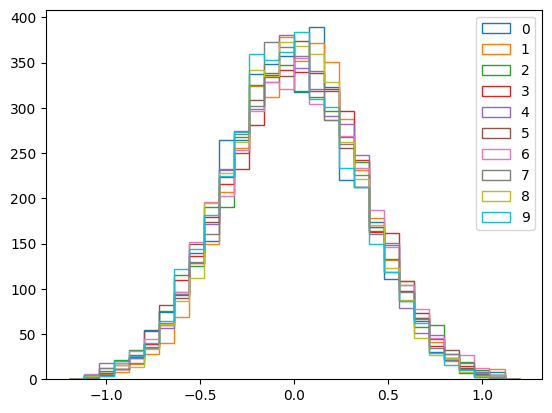

In [31]:
for i in range(10):
    plt.hist(z[:,i].detach().cpu().numpy(), bins=30, range=(-1.2,1.2), label=f"{i}", histtype="step")
    print(i, z[:,i].mean(), z[:,i].std())

plt.legend()

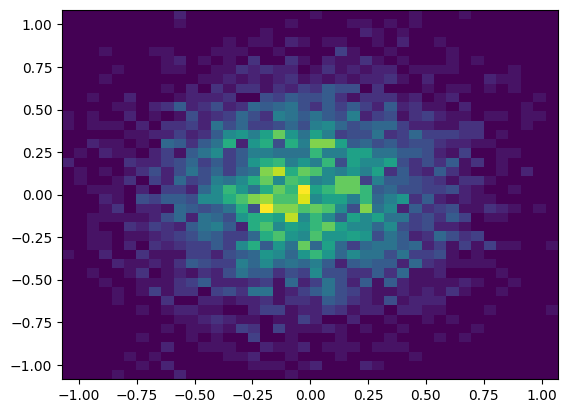

In [32]:
plt.hist2d(z[:,9].detach().cpu().numpy(), z[:,4].detach().cpu().numpy(),
          bins=40);

In [68]:
F= model.flow(flow_cond_vector)

In [73]:
with torch.no_grad():
    samples, W  = F.rsample_and_log_prob((100,))

(array([  1.,  11.,  49., 130., 209., 243., 145., 104.,  70.,  38.]),
 array([-6.27757906, -3.36715968, -0.4567403 ,  2.45367908,  5.36409846,
         8.27451784, 11.18493722, 14.09535659, 17.00577597, 19.91619535,
        22.82661473]),
 <BarContainer object of 10 artists>)

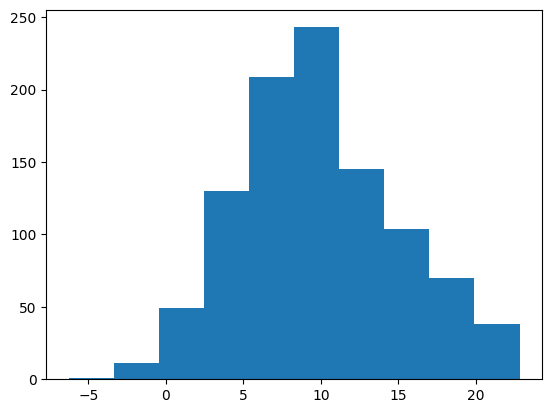

In [77]:
plt.hist(W.cpu().flatten().numpy())

In [79]:
with torch.no_grad():
    ps_samples, W = model.flow(flow_cond_vector).rsample_and_log_prob((1000,))

ps_new = torch.sigmoid(ps_samples*scale_ps + mean_ps)

(array([1.800000e+02, 1.668000e+03, 3.323000e+03, 1.813620e+05,
        1.272853e+06, 5.623310e+05, 2.371700e+04, 1.807000e+03,
        7.430000e+02, 1.600000e+01]),
 array([-1.67990742, -1.32193173, -0.96395604, -0.60598035, -0.24800466,
         0.10997103,  0.46794672,  0.8259224 ,  1.18389809,  1.54187378,
         1.89984947]),
 <BarContainer object of 10 artists>)

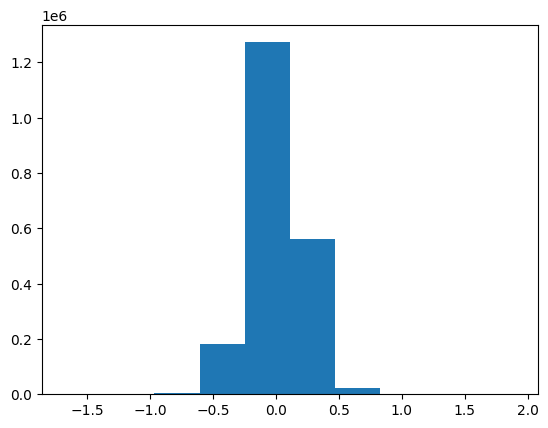

In [35]:
plt.hist(ps_samples.cpu().flatten())

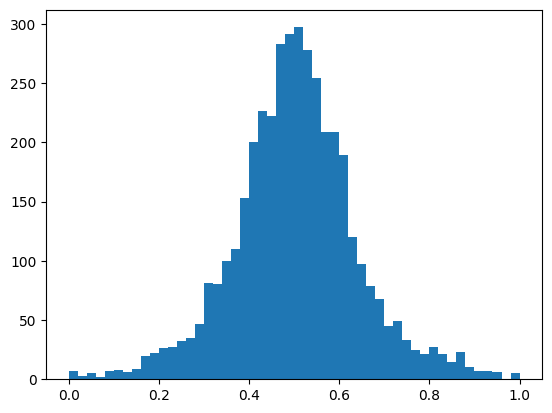

In [36]:
plt.hist(ps_new[:,1,2].cpu(), bins=50);

In [37]:
(ps_new > 1).sum()

tensor(0, device='cuda:0')

In [38]:
(ps_new<0).sum(dim=[0, 2]) / 2048

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.], device='cuda:0')

In [39]:
(ps_new>1).sum(dim=[0, 2]) / 2048

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.], device='cuda:0')

In [40]:
(ps_new > 1).sum()/ (ps_new > 0).sum()

tensor(0., device='cuda:0')

In [41]:
ps_samples[0,:,0]

tensor([-0.1319,  0.1309, -0.0284, -0.3341,  0.4874,  0.0205,  0.0537, -0.4070,
        -0.1900,  0.1918,  0.5595,  0.1741, -0.2008, -0.2277,  0.1180, -0.0866,
         0.1866,  0.0746, -0.1556, -0.2657,  0.1066,  0.1272, -0.0475, -0.1701,
        -0.0028,  0.3686,  0.0981, -0.0060,  0.2060, -0.0956, -0.2162, -0.0490,
         0.1151, -0.2205, -0.1143,  0.2947, -0.2480, -0.1436, -0.0030,  0.0266,
        -0.0346, -0.2218, -0.3249,  0.3637, -0.0167,  0.1790, -0.0749,  0.1192,
         0.0624,  0.0107], device='cuda:0')

In [80]:
ps_new_flat = ps_new.flatten(0, 1)
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
momenta_original = momenta.reshape(-1,ps_new.shape[1], 6, 4).transpose(1, 0)
x1pp = x1pp.reshape(-1, ps_new.shape[1]).transpose(1,0)
x2pp = x2pp.reshape(-1, ps_new.shape[1]).transpose(1,0)
H, t1, t2, isr = get_particle_awkward(parton_cartesian.cpu())
Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta_original.cpu())

Hr, t1r, t2r, isrr = get_particle_awkward(data_regressed_cm.cpu())

x1 = (boost_parton[:,0,0]+boost_parton[:,0,3])/E_CM
x2 = (boost_parton[:,0,0]-boost_parton[:,0,3])/E_CM

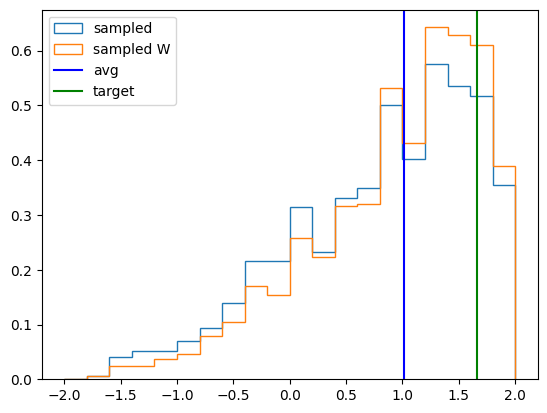

In [92]:
plt.hist(Hs.eta[8,:], bins=20, range=(-2,2), histtype="step", label="sampled", density=True)
plt.hist(Hs.eta[8,:], bins=20, weights=W.cpu().numpy()[:, 8], range=(-2,2), histtype="step", label="sampled W", density=True)

plt.axvline(ak.mean(Hs.eta[8,:]),  label="avg", c="b")
plt.axvline(H.eta[8], c="g", label="target")
plt.legend()

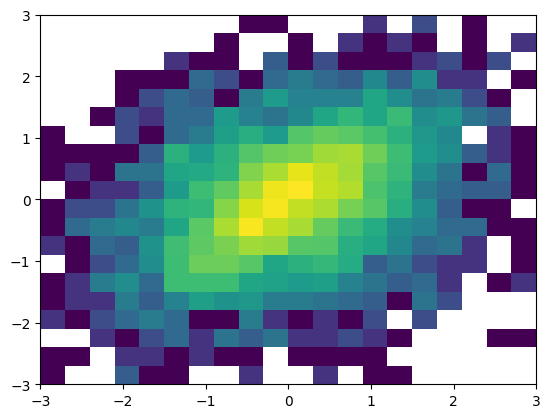

In [26]:
plt.hist2d(H.eta.to_numpy(), Hs.eta[:,1].to_numpy(), 
           bins=20, range=((-3,3),(-3,3)), norm=LogNorm());

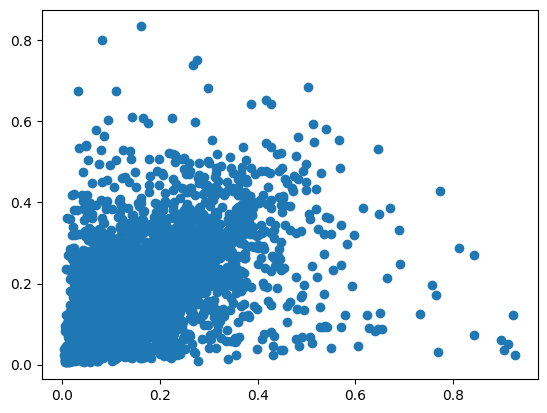

In [47]:
plt.scatter(x2pp.mean(1).cpu().numpy(), x2.cpu().numpy())

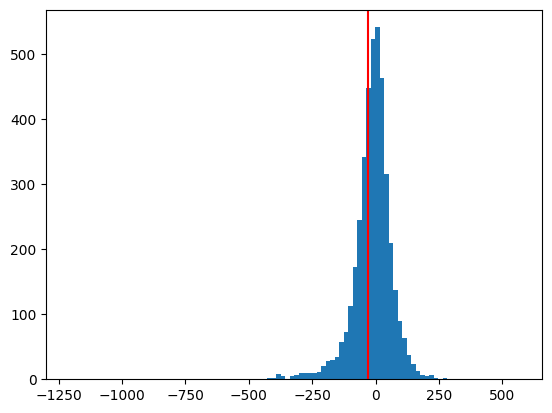

In [44]:
plt.hist(momenta_original[0, :, 3, 3].cpu(), bins=100);
plt.axvline(parton_cartesian[0, 0,3].cpu(), c="red")

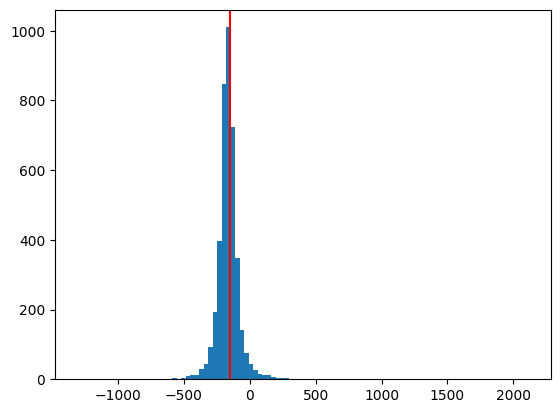

In [45]:
plt.hist(momenta_original[1, :, 3, 3].cpu(), bins=100);
plt.axvline(parton_cartesian[1, 1,3].cpu(), c="red")

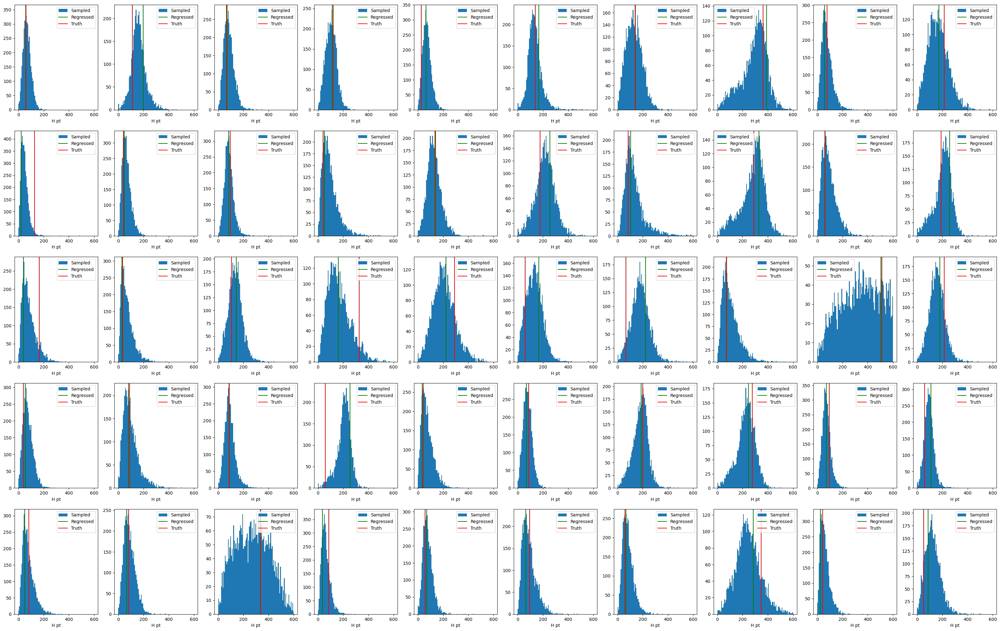

In [46]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].pt, bins=100, range=(0, 600), label="Sampled");
        axs[i][j].axvline(Hr[n].pt, c="green", label="Regressed")
        axs[i][j].axvline(H[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("H pt")
        axs[i][j].legend()

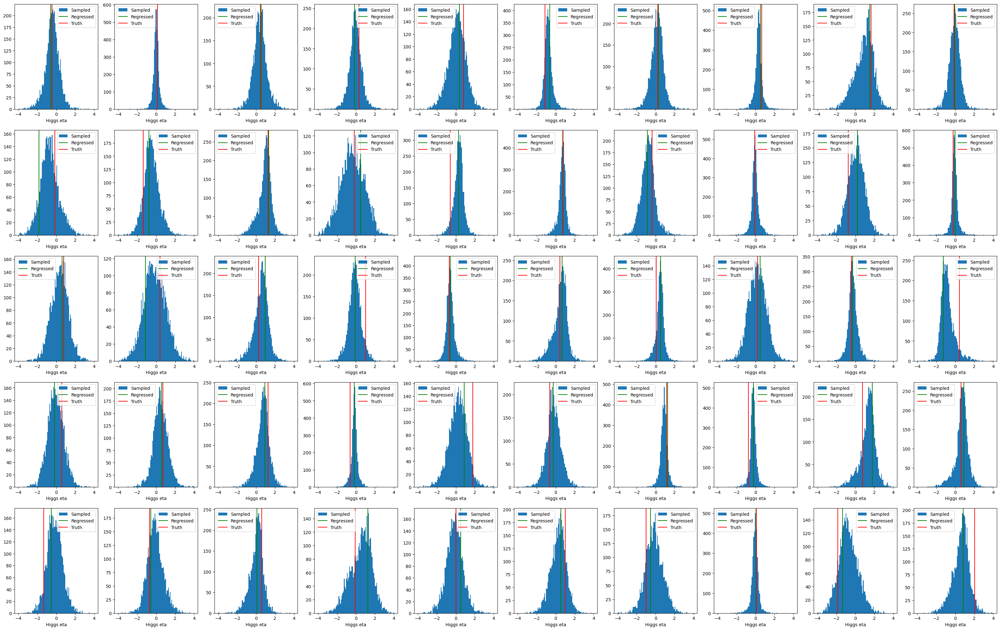

In [47]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].eta, bins=100,  range=(-4,4), label="Sampled");
        axs[i][j].axvline(Hr[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs eta")
        axs[i][j].legend()

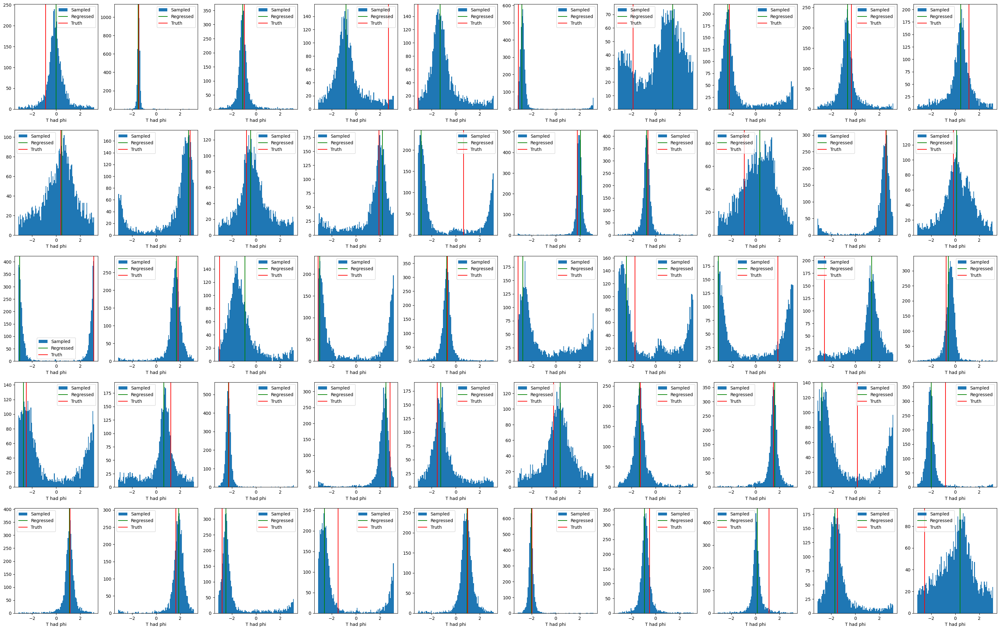

In [48]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].phi, bins=100,  range=(-np.pi,np.pi), label="Sampled");
        axs[i][j].axvline(t1r[n].phi, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].phi, c="red", label="Truth")
        axs[i][j].set_xlabel("T had phi")
        axs[i][j].legend()

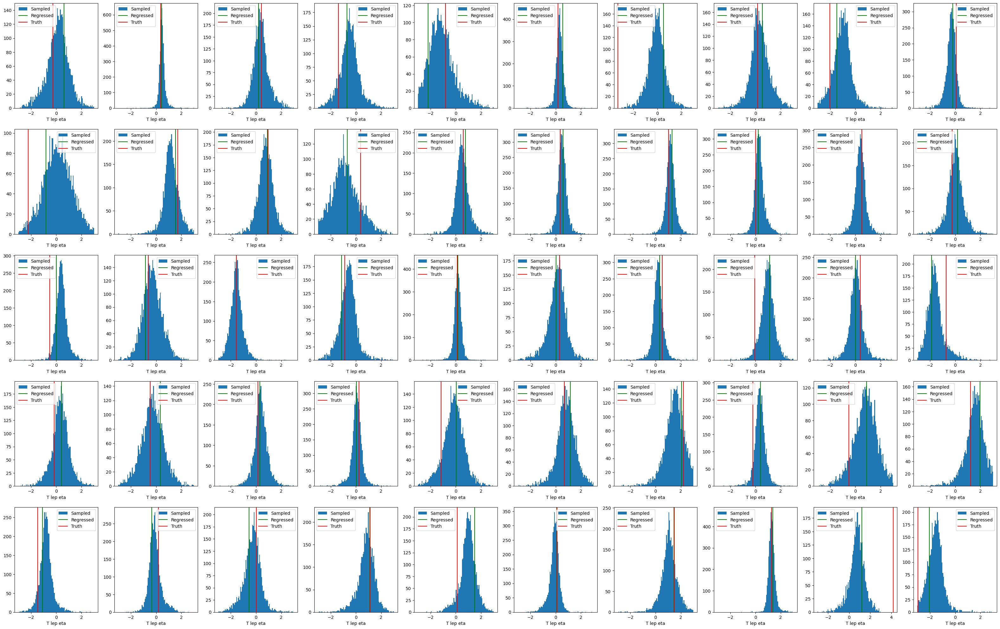

In [49]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t2s[n].eta, bins=100,  range=(-3,3), label="Sampled");
        axs[i][j].axvline(t2r[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(t2[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("T lep eta")
        axs[i][j].legend()

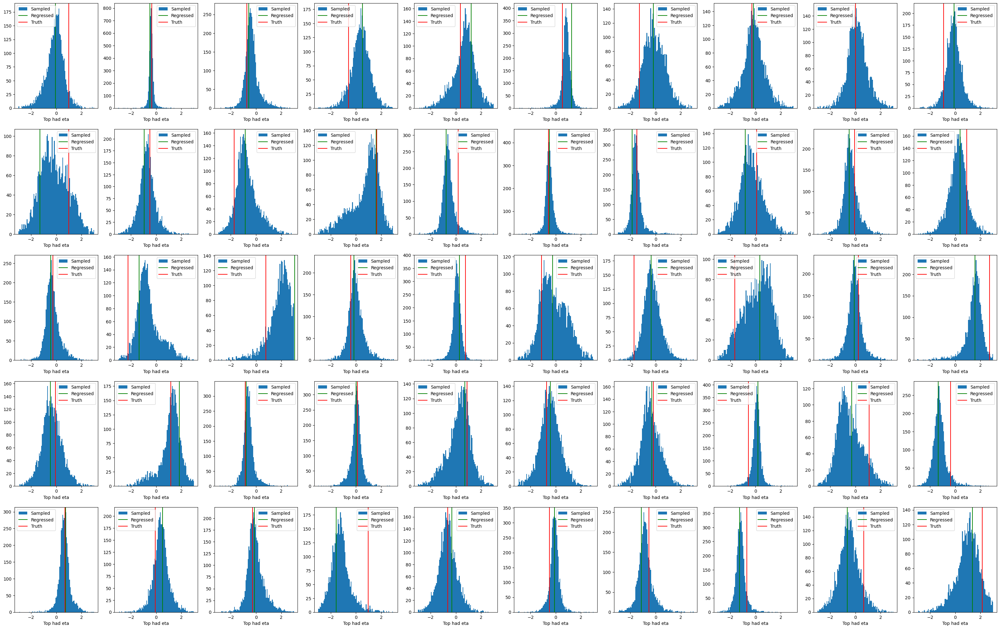

In [50]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].eta, bins=100,  range=(-3,3), label="Sampled");
        axs[i][j].axvline(t1r[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had eta")
        axs[i][j].legend()

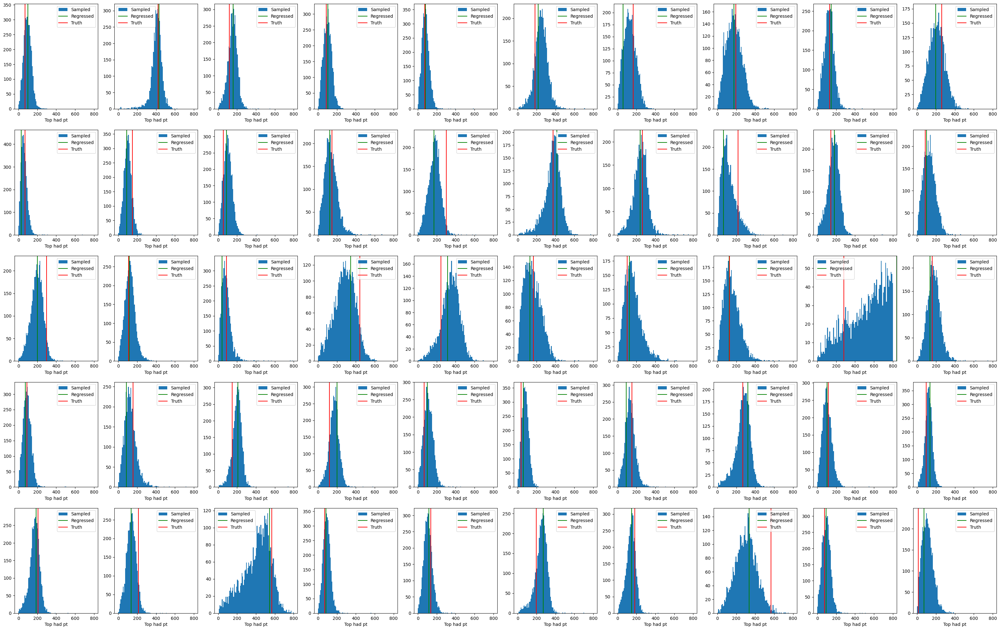

In [51]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].pt, bins=100,  range=(0,800), label="Sampled");
        axs[i][j].axvline(t1r[n].pt, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had pt")
        axs[i][j].legend()

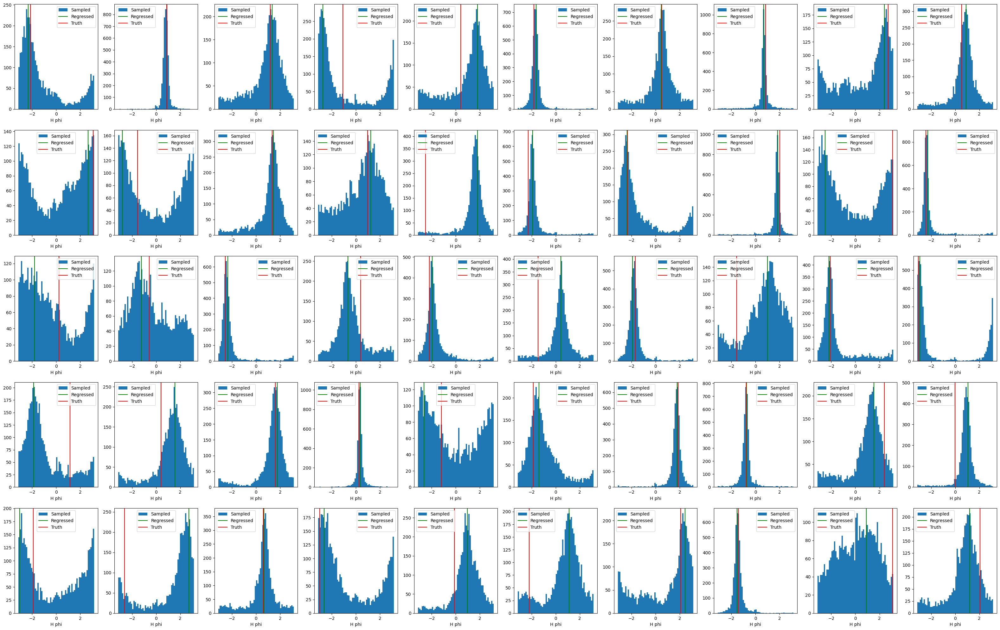

In [52]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].phi, bins=60, range=(-np.pi, np.pi), label="Sampled");
        axs[i][j].axvline(Hr[n].phi, c="green", label="Regressed")
        axs[i][j].axvline(H[n].phi, c="red", label="Truth")
        axs[i][j].set_xlabel("H phi")
        axs[i][j].legend()

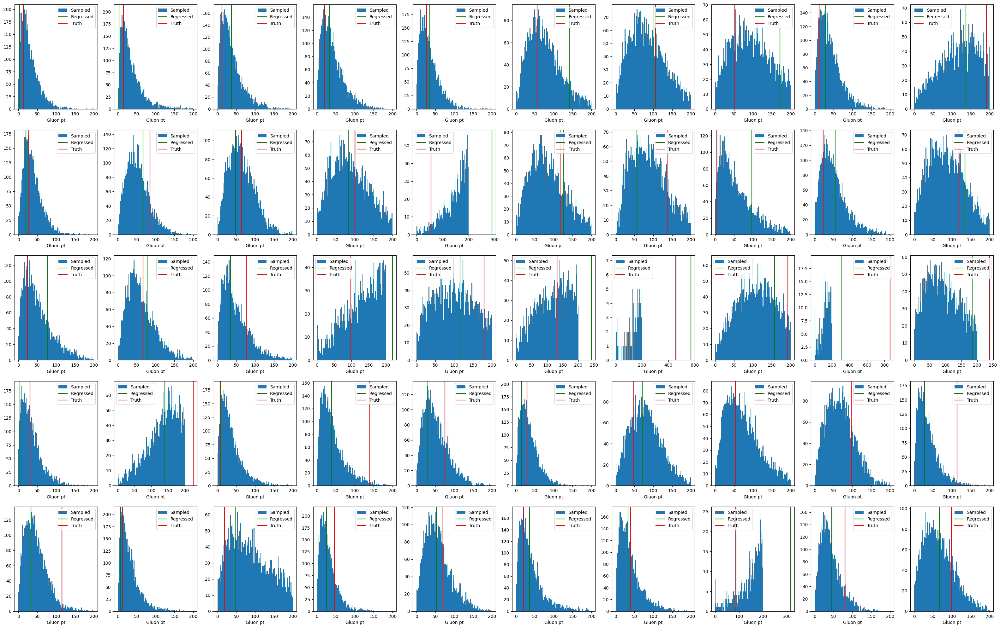

In [53]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(isrs[n].pt, bins=100,  range=(0,200), label="Sampled");
        axs[i][j].axvline(isrr[n].pt, c="green",label="Regressed")
        axs[i][j].axvline(isr[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon pt")
        axs[i][j].legend()

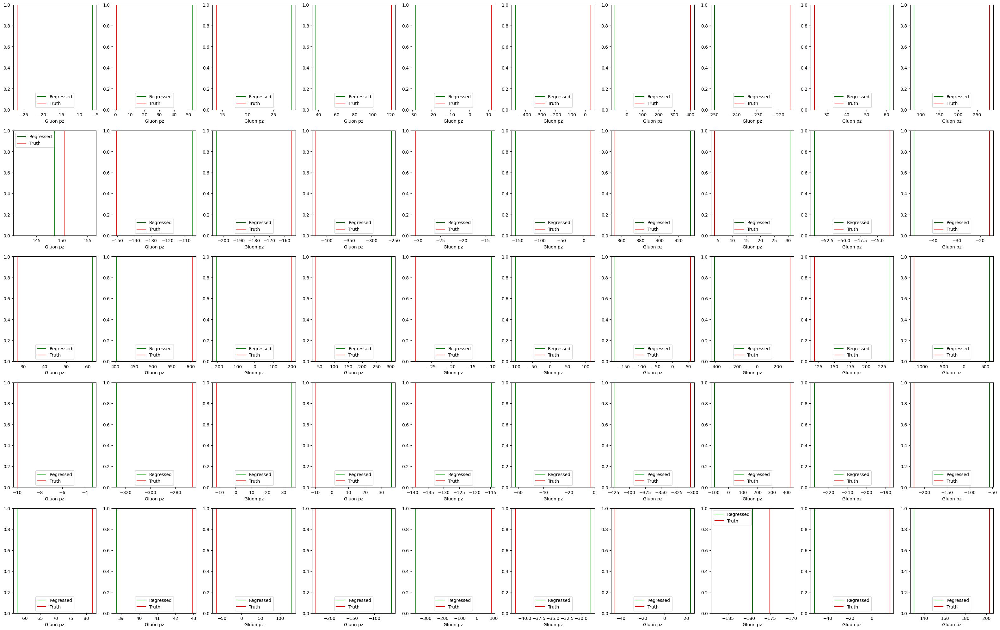

In [54]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].axvline(isrr[n].pz, c="green",label="Regressed")
        axs[i][j].axvline(isr[n].pz, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon pz")
        axs[i][j].legend()

In [39]:
x1pp.shape

torch.Size([50, 3000])

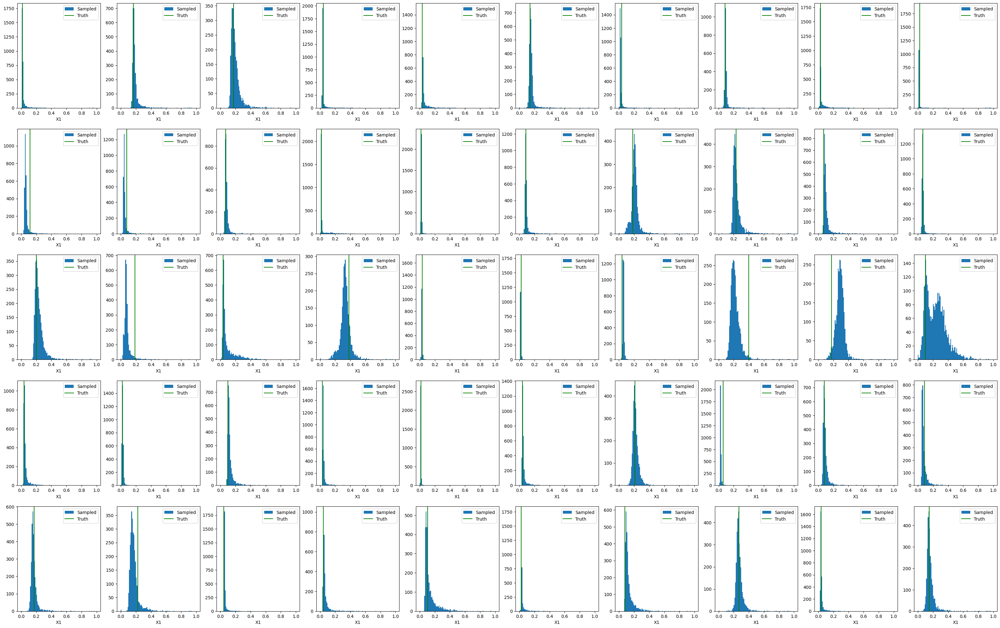

In [42]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(x1pp[n].cpu().numpy(), bins=100, range=(0,1), label="Sampled")
        axs[i][j].axvline(x1[n].cpu(), c="green",label="Truth")
        axs[i][j].set_xlabel("X1")
        axs[i][j].legend()

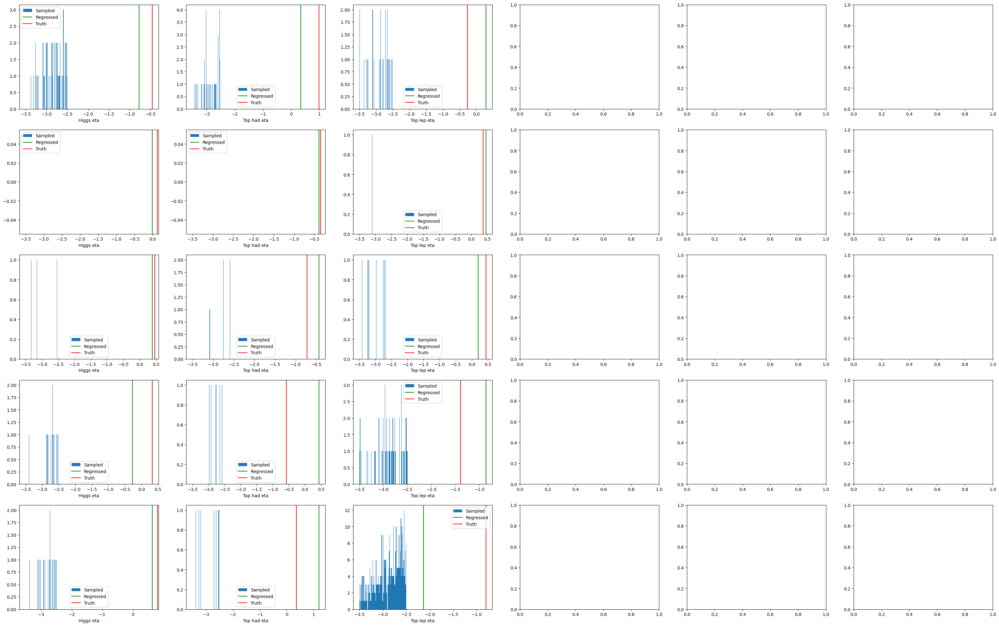

In [48]:
f, axs = plt.subplots(5, 6, figsize=(40, 25))
for i in range(5):
    axs[i][0].hist(Hs[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][0].axvline(Hr[i].eta, c="green", label="Regressed")
    axs[i][0].axvline(H[i].eta, c="red", label="Truth")
    axs[i][0].set_xlabel("Higgs eta")
    axs[i][0].legend()

    axs[i][1].hist(t1s[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][1].axvline(t1r[i].eta, c="green", label="Regressed")
    axs[i][1].axvline(t1[i].eta, c="red", label="Truth")
    axs[i][1].set_xlabel("Top had eta")
    axs[i][1].legend()

    axs[i][2].hist(t2s[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][2].axvline(t2r[i].eta, c="green", label="Regressed")
    axs[i][2].axvline(t2[i].eta, c="red", label="Truth")
    axs[i][2].set_xlabel("Top lep eta")
    axs[i][2].legend()

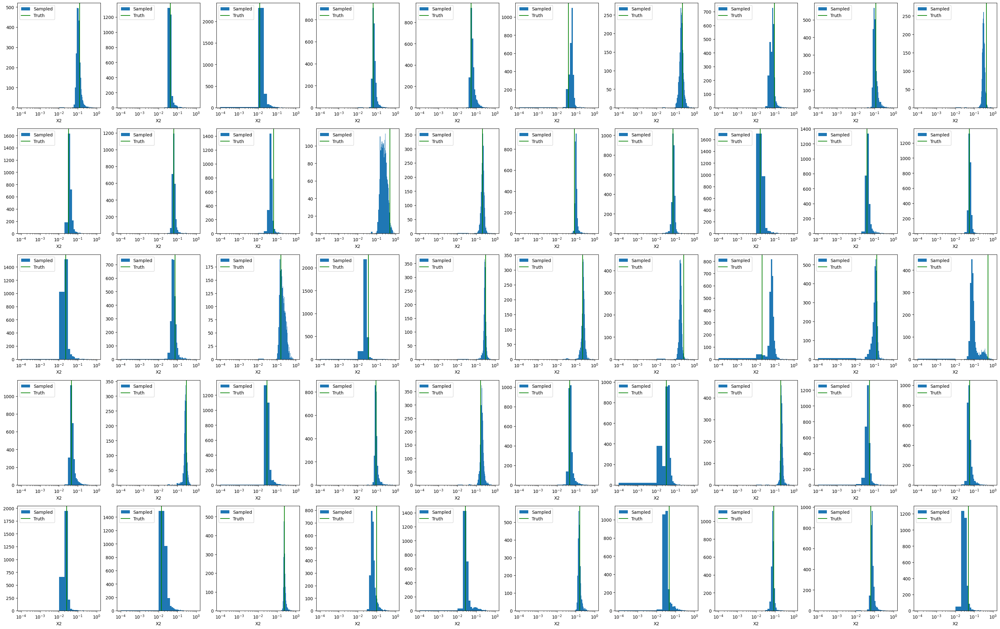

In [45]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(x2pp[n].cpu().numpy(), bins=100, range=(1e-4,1), label="Sampled")
        axs[i][j].axvline(x2[n].cpu(), c="green",label="Truth")
        axs[i][j].set_xlabel("X2")
        axs[i][j].set_xscale("log")
        axs[i][j].legend()

# Load presaved output with large samples

In [55]:
import h5py

df = h5py.File("/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/flow_flow_sampling_v3c-sampling_DiagNormal_NoTransf6_NoBins40_DNN2_512/samples_30k_50events.hdf5")

In [56]:
ps_samples = torch.from_numpy(df["flow_samples"][()]).to("cuda")
ps_samples.shape

torch.Size([50, 30000, 10])

In [57]:
ps_unscaled = torch.sigmoid(ps_samples*scale_ps + mean_ps)
ps_new_flat = ps_unscaled.flatten(0, 1)
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
x1pp = x1pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
x2pp = x2pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
momenta = momenta.reshape(-1,ps_unscaled.shape[1], 6, 4)#.transpose(1, 0)

Nevents= ps_samples.shape[0]
H, t1, t2, isr = get_particle_awkward(parton_cartesian[0:Nevents].cpu())

Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta.cpu())

Hr, t1r, t2r, isrr = get_particle_awkward(data_regressed_cm[0:Nevents].cpu())


x1 = (boost_parton[:Nevents,0,0]+boost_parton[:Nevents,0,3])/E_CM
x2 = (boost_parton[:Nevents,0,0]-boost_parton[:Nevents,0,3])/E_CM

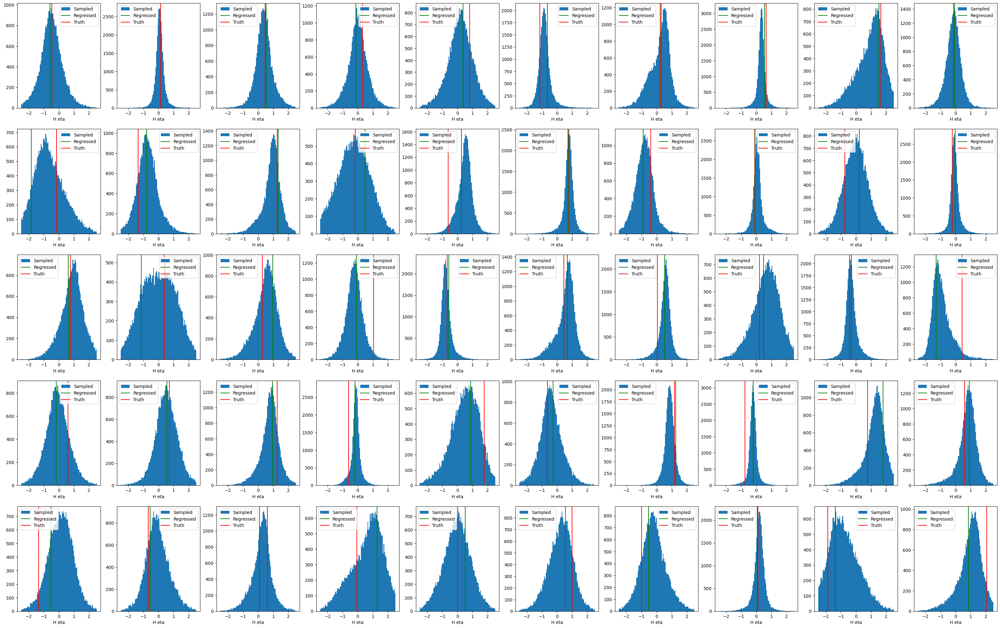

In [58]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].eta, bins=100, range=(-2.5, 2.5), label="Sampled");
        axs[i][j].axvline(Hr[n].eta, c="green", label="Regressed")
        axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("H eta")
        axs[i][j].legend()

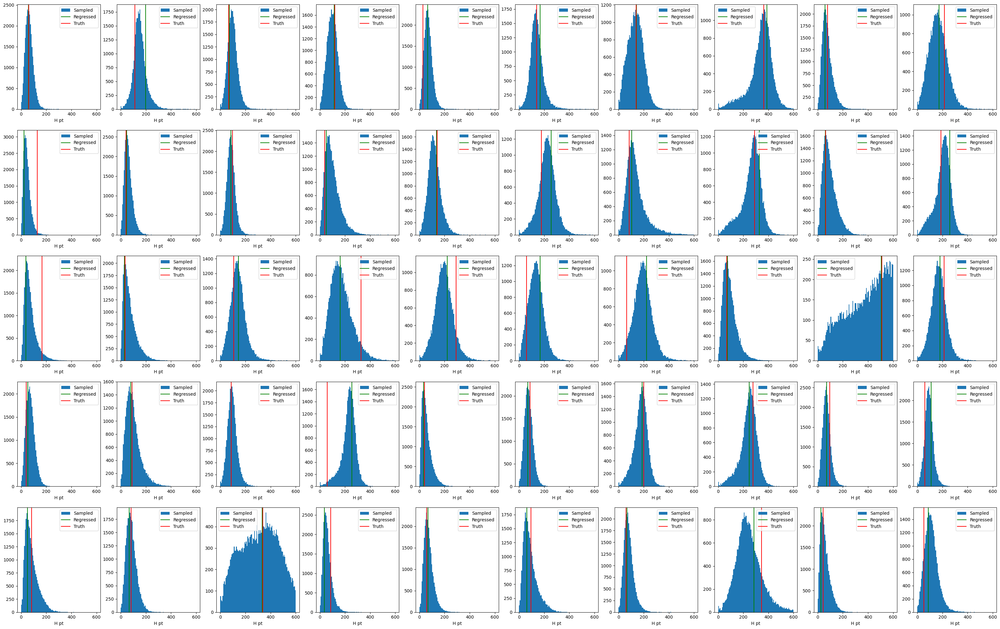

In [59]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].pt, bins=100, range=(0, 600), label="Sampled");
        axs[i][j].axvline(Hr[n].pt, c="green", label="Regressed")
        axs[i][j].axvline(H[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("H pt")
        axs[i][j].legend()

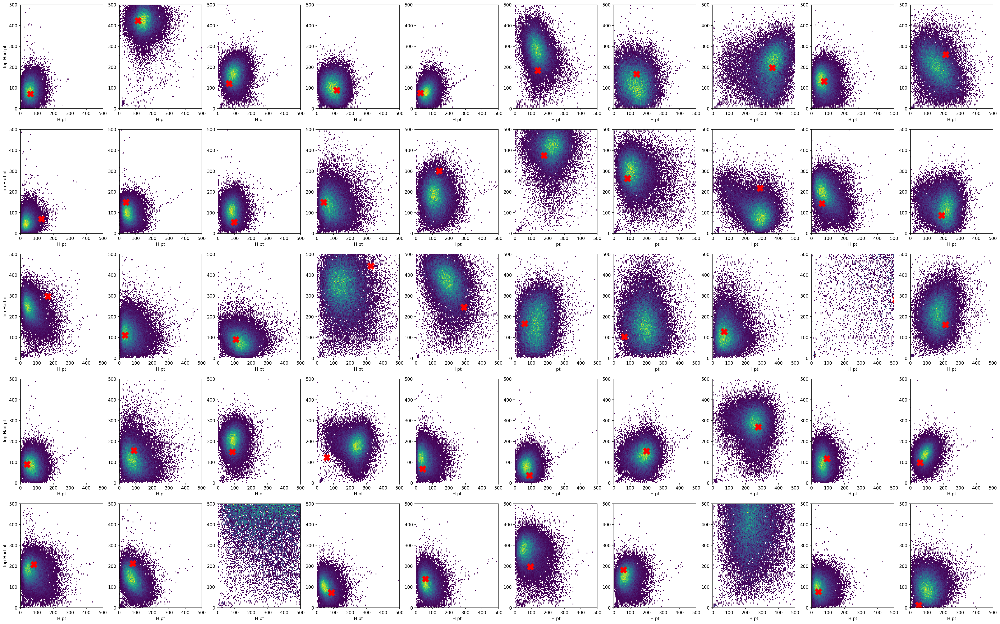

In [61]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].pt.to_numpy(), t1s[n].pt.to_numpy(), range=((0,500),(0,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].pt, t1[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].pt, t1r[n].pt, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("H pt")
        #axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had pt")
        

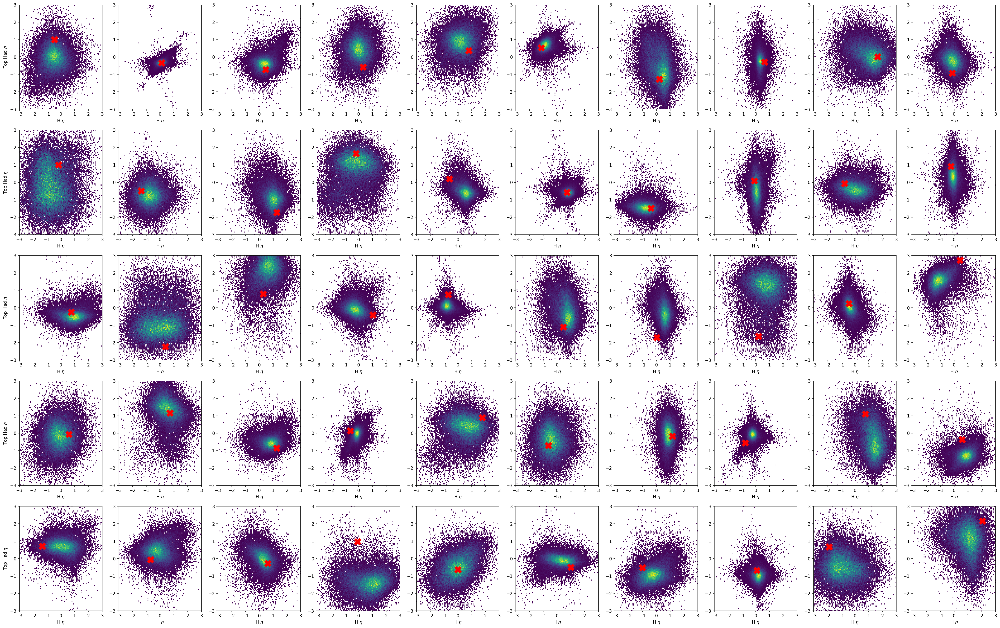

In [62]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), t1s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, t1[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("H $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top Had $\eta$")
        

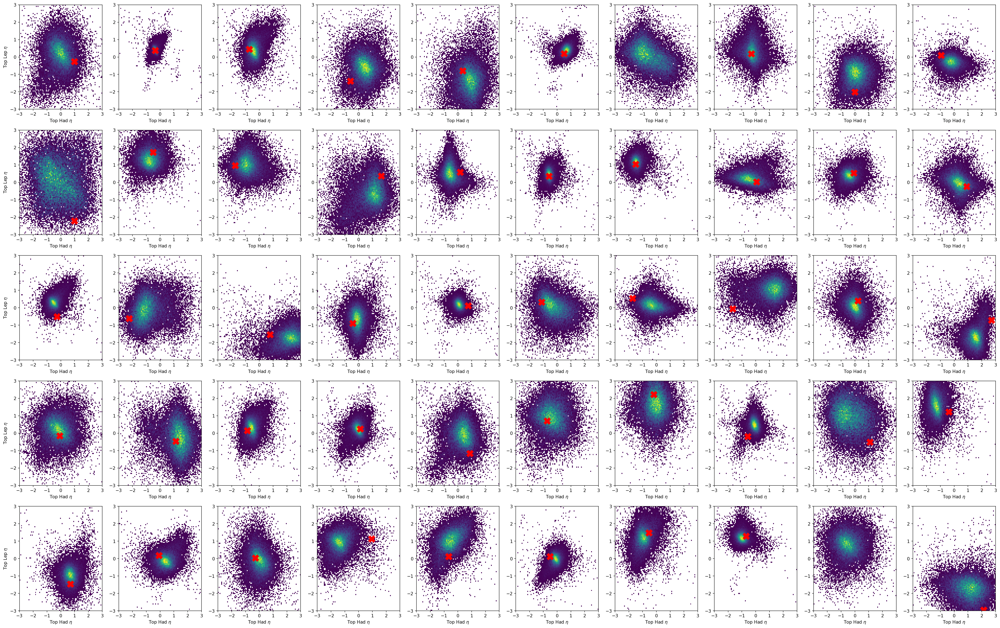

In [63]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].eta.to_numpy(), t2s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].eta, t2[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Had $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\eta$")
        

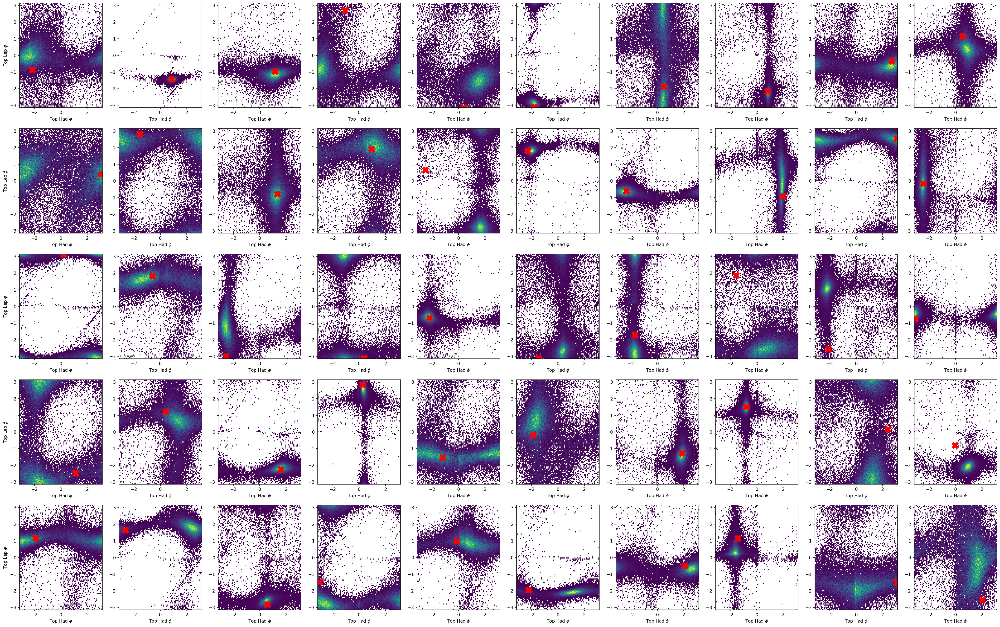

In [64]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].phi.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].phi, t1[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Had $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\phi$")
        

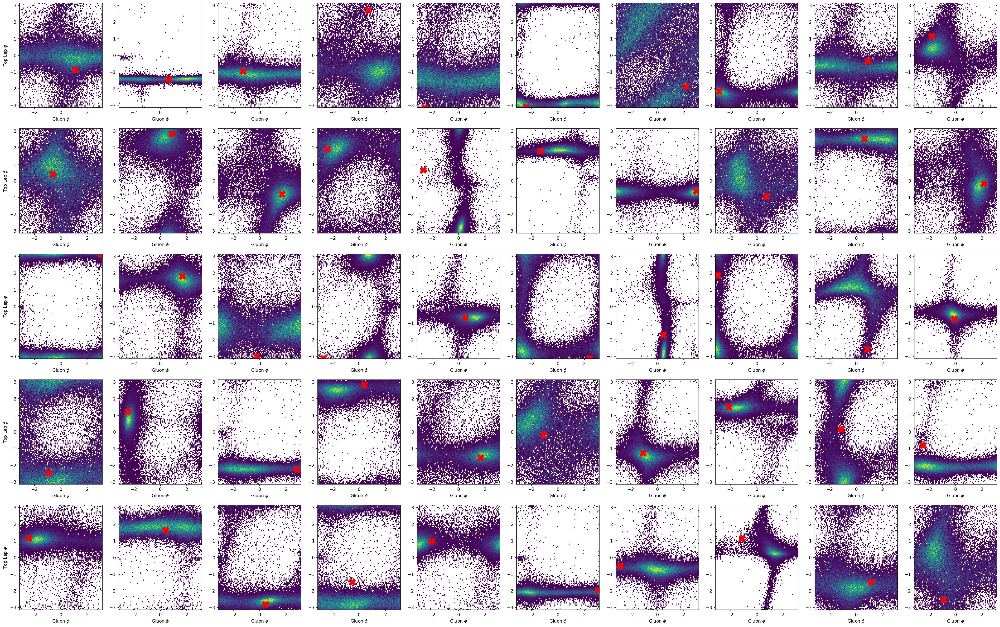

In [65]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].phi.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].phi, t1[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\phi$")
        

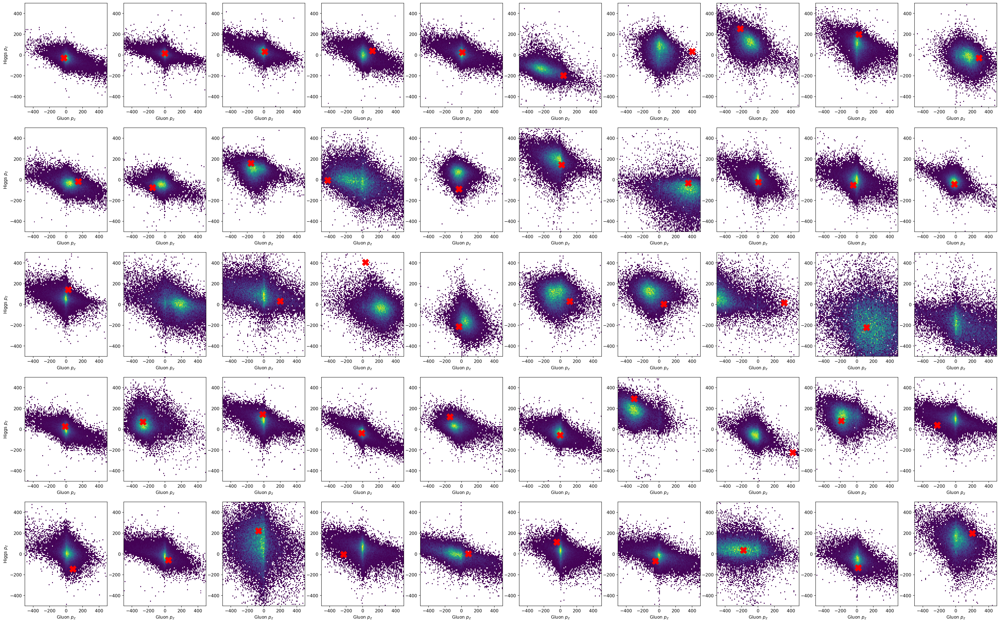

In [66]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].pz.to_numpy(), Hs[n].pz.to_numpy(), range=((-500,500),(-500,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].pz, H[n].pz, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $p_z$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $p_z$")
        

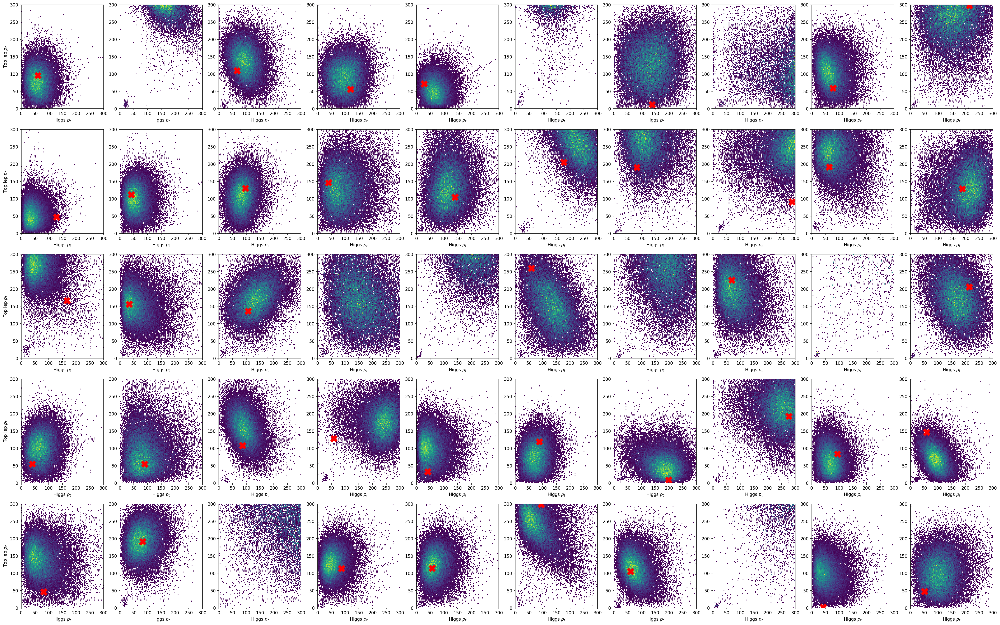

In [67]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].pt.to_numpy(), t2s[n].pt.to_numpy(), range=((0,300),(0,300)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].pt, t2[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $p_t$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $p_t$")
        

# Scatter singola particella

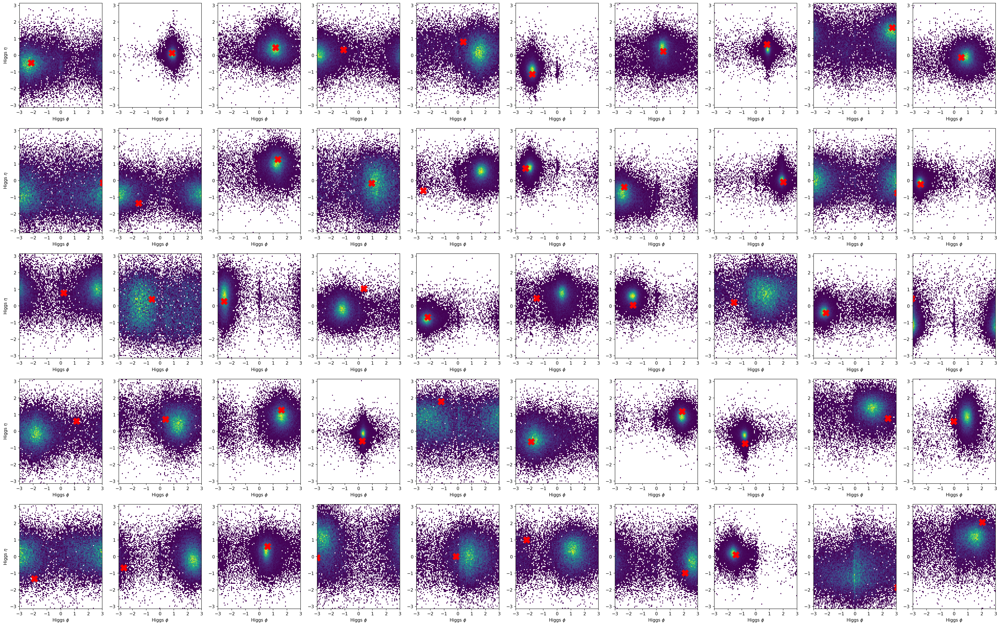

In [68]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].phi.to_numpy(), Hs[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].phi, H[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $\eta$")
        

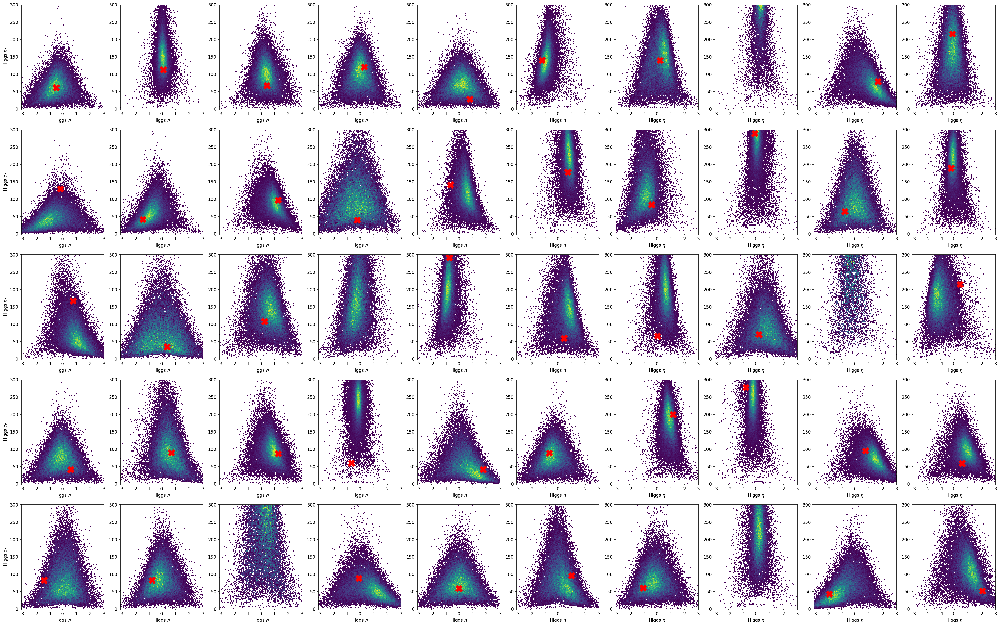

In [69]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), Hs[n].pt.to_numpy(), range=((-3,3),(0, 300)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, H[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $p_t$")
        

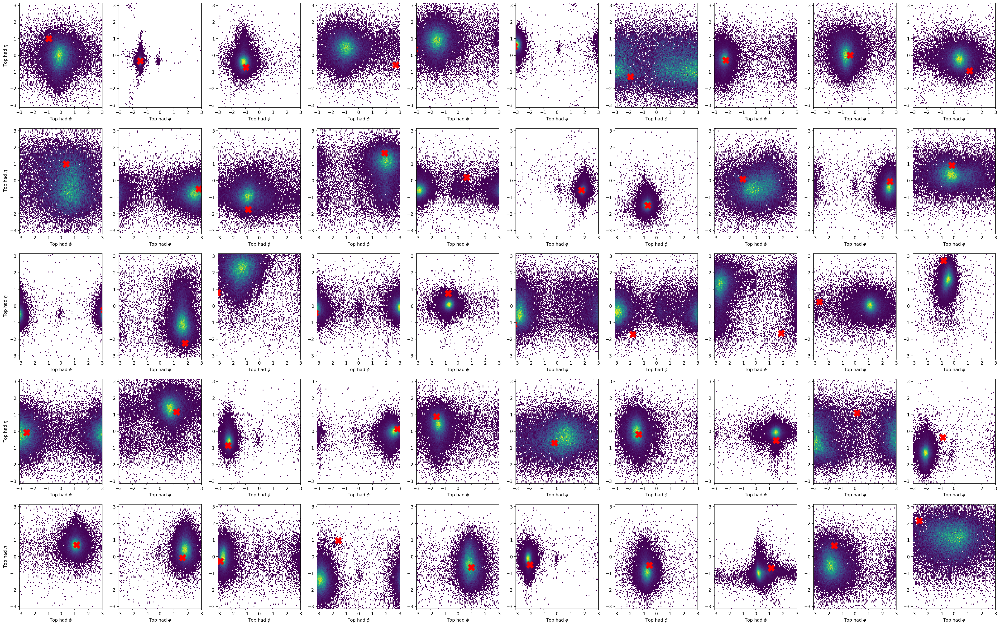

In [70]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].phi.to_numpy(), t1s[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].phi, t1[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top had $\eta$")
        

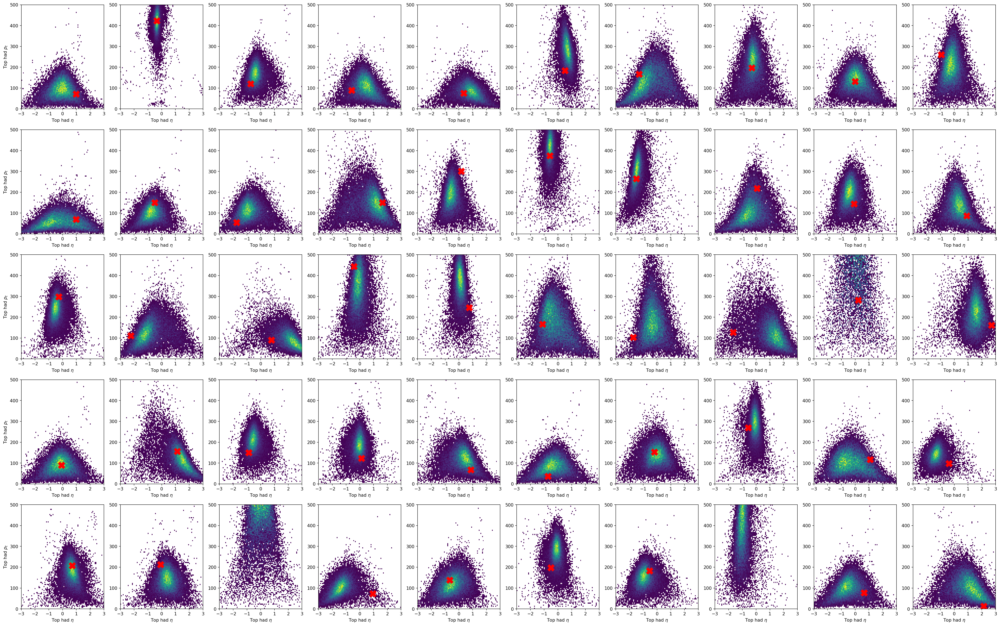

In [71]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].eta.to_numpy(), t1s[n].pt.to_numpy(), range=((-3,3),(0, 500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].eta, t1[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top had $p_t$")
        

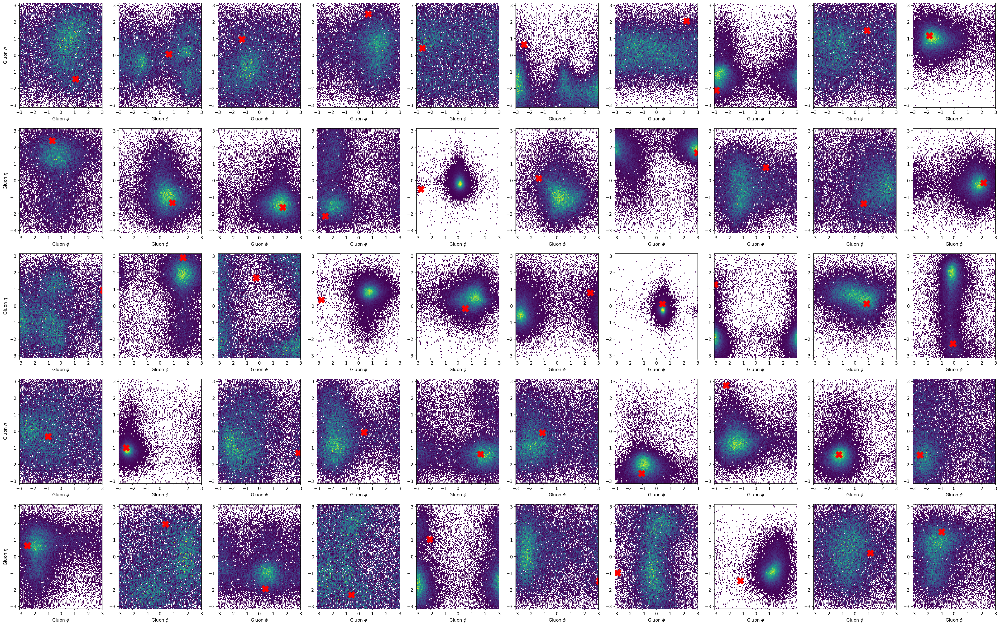

In [72]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].phi.to_numpy(), isrs[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].phi, isr[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Gluon $\eta$")
        

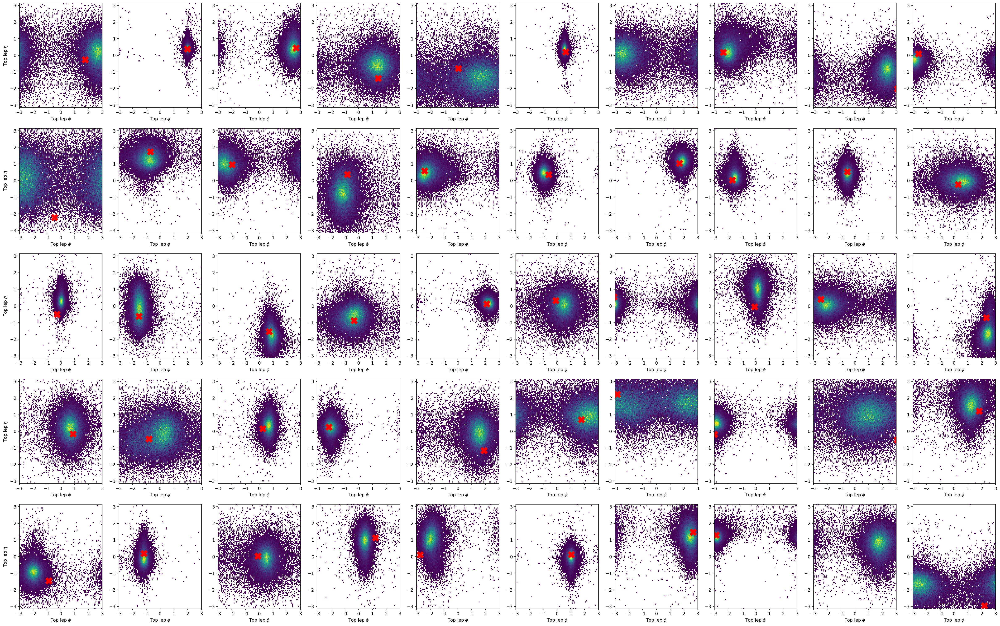

In [73]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t2s[n].phi.to_numpy(), t2s[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].phi, t2[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top lep $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $\eta$")
        

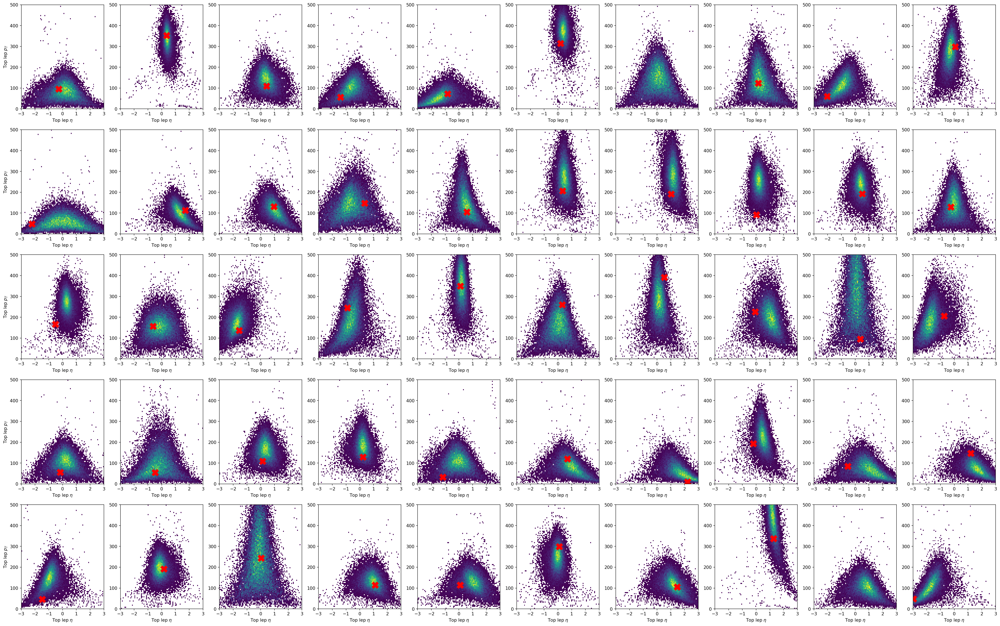

In [74]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t2s[n].eta.to_numpy(), t2s[n].pt.to_numpy(), range=((-3,3),(0,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].eta, t2[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top lep $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $p_T$")
        

# Regression after the flow

In [10]:
import h5py
df = h5py.File("/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/flow_flow_sampling_v3c-sampling_DiagNormal_NoTransf6_NoBins40_DNN2_512/samples_40.hdf5")

In [76]:
df.keys()

<KeysViewHDF5 ['boost', 'flow_samples', 'logprob', 'part_CM_Epxpypz', 'part_lab_ptetaphi', 'ps']>

In [11]:
(higgs_regr_CM, thad_regr_CM, tlep_regr_CM, isr_regr_CM) = get_particle_awkward(torch.from_numpy(df["part_CM_Epxpypz"][()] )) # it is in the CM
boost_regr = torch.from_numpy(df['boost'][()])
boost_regr = boost_regr*log_std_boost.to("cpu") + log_mean_boost.to("cpu") 
boost_regr[:,0] = torch.exp(boost_regr[:,0]) - 1

In [14]:
# Need to unscale the particle in the lab
partons_lab = torch.from_numpy(df["part_lab_ptetaphi"][()])
partons_lab = partons_lab*log_std_parton_lab.to("cpu")  + log_mean_parton_lab.to("cpu") 
partons_lab[:,:,0] = torch.exp(partons_lab[:,:, 0]) - 1
(higgs_regr_lab, thad_regr_lab, tlep_regr_lab, isr_regr_lab) = get_particle_awkward_ptetaphi(partons_lab)

In [84]:
higgs_regr_CM

<MomentumArray4D [{x: -34.9, y: -40.9, z: ..., ...}, ...] type='1792125 * M...'>

In [85]:
delta_pt = higgs_regr_CM.pt - higgsCorrect.pt

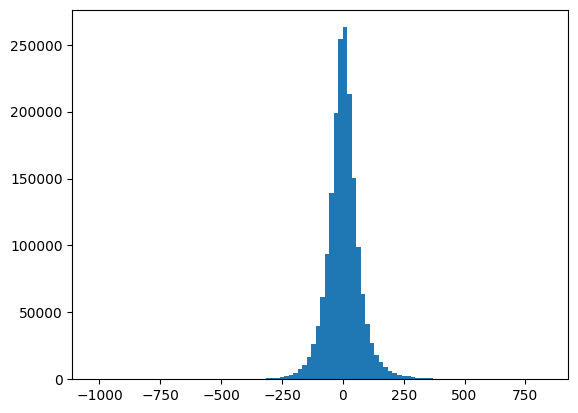

In [86]:
plt.hist(delta_pt, bins=100);

In [25]:
delta_pt.to_numpy()

array([  -9.81899587,   24.79756265,   12.37453488, ...,   16.84044091,
        -96.53572661, -127.50057696])

## Higgs

Text(0.5, 1.0, 'ISR')

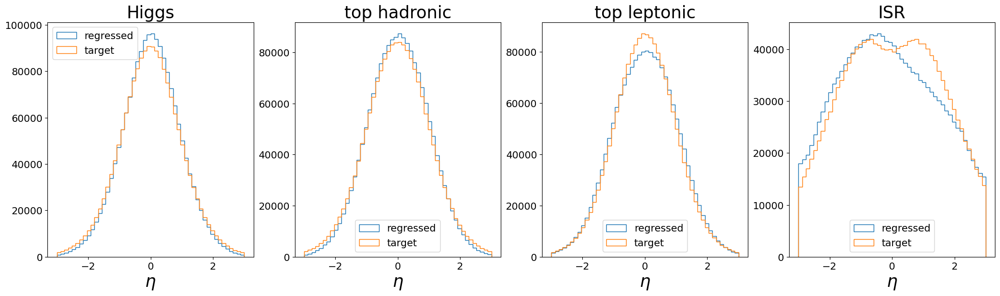

In [15]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(higgs_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[0].hist(higgsCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$\eta$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(thad_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[1].hist(thadCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$\eta$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(tlep_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[2].hist(tlepCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$\eta$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isr_regr_lab.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[3].hist(glISRCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$\eta$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

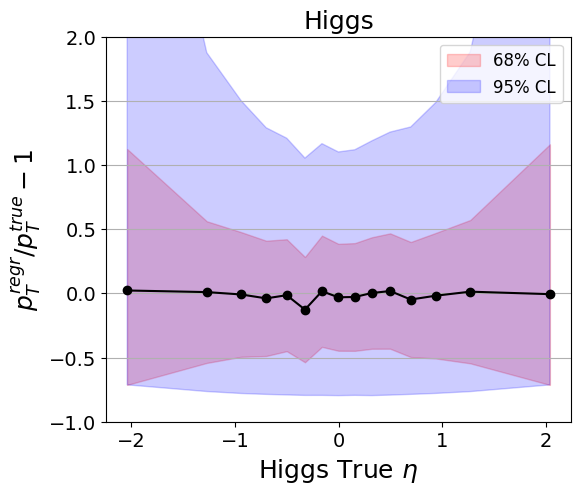

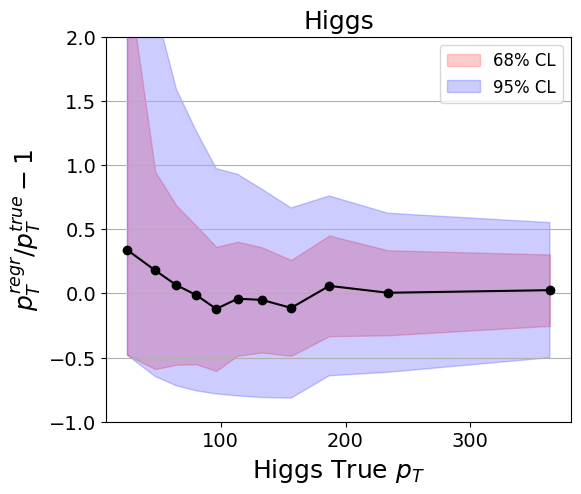

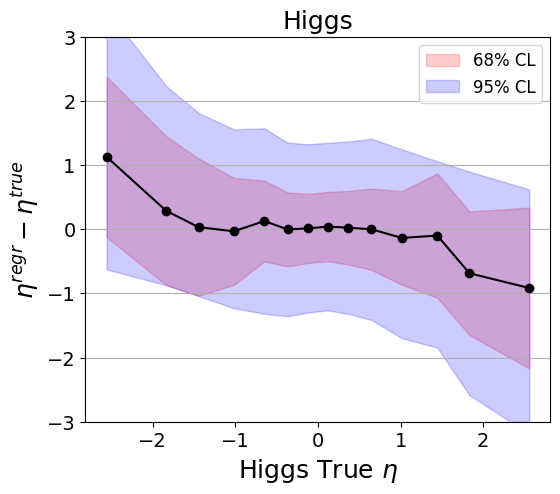

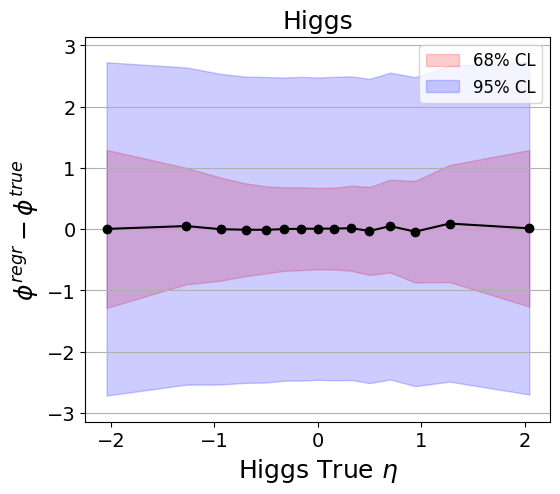

In [16]:
plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.pt.to_numpy(),  
                        cat_var=higgsCorrect.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((higgs_regr_CM.eta - higgsCorrect.eta ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(higgs_regr_CM.deltaphi(higgsCorrect).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

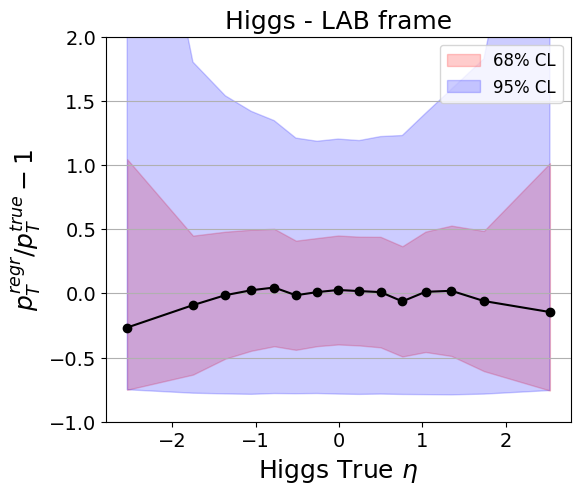

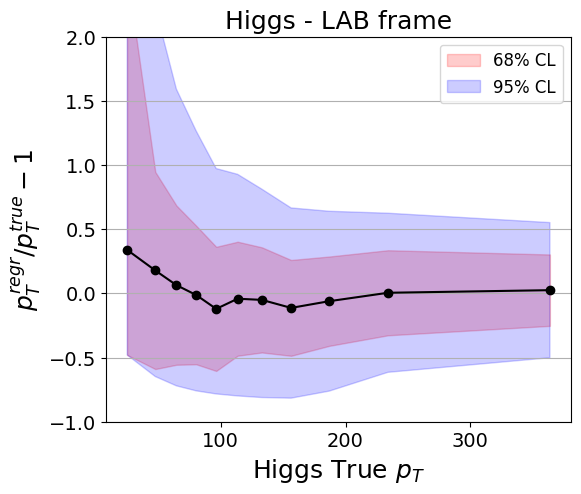

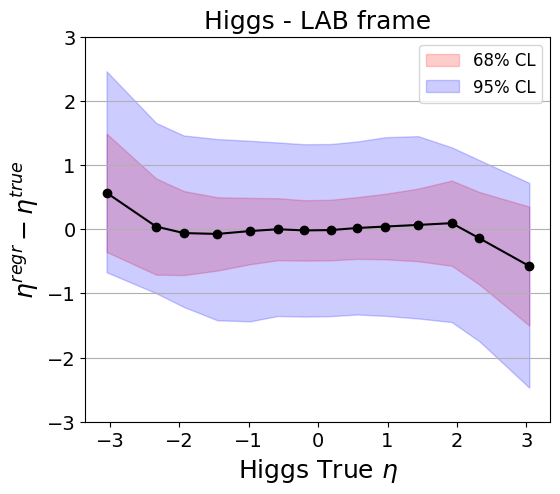

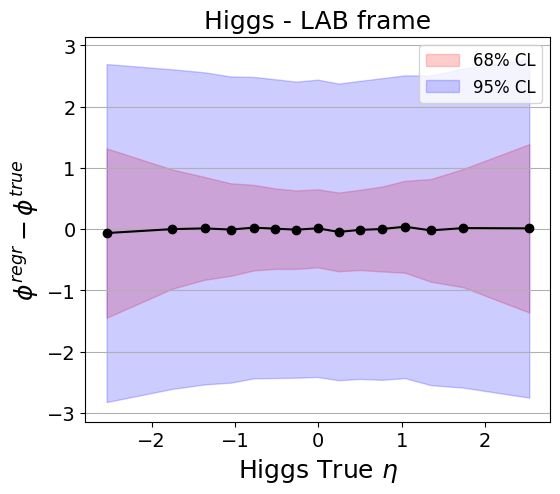

In [89]:
plot_diff_mode_quantile((higgs_regr_lab.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs - LAB frame')

plot_diff_mode_quantile((higgs_regr_lab.pt/ higgsCorrect_lab.pt  -1 ).to_numpy(), 
                        X=higgsCorrect_lab.pt.to_numpy(),  
                        cat_var=higgsCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs - LAB frame')

plot_diff_mode_quantile((higgs_regr_lab.eta - higgsCorrect_lab.eta ).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs - LAB frame')

plot_diff_mode_quantile(higgs_regr_lab.deltaphi(higgsCorrect_lab).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs - LAB frame') 

In [90]:
np.quantile(higgsCorrect.eta.to_numpy(), [0,0.02, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.98, 1.])

array([-7.99701446e+00, -2.16244597e+00, -1.66514879e+00, -1.26289345e+00,
       -8.09765483e-01, -5.00052501e-01, -2.41238014e-01, -1.58979843e-03,
        2.38014859e-01,  4.96829534e-01,  8.08347648e-01,  1.26217023e+00,
        1.66564313e+00,  2.15776079e+00,  7.95132417e+00])

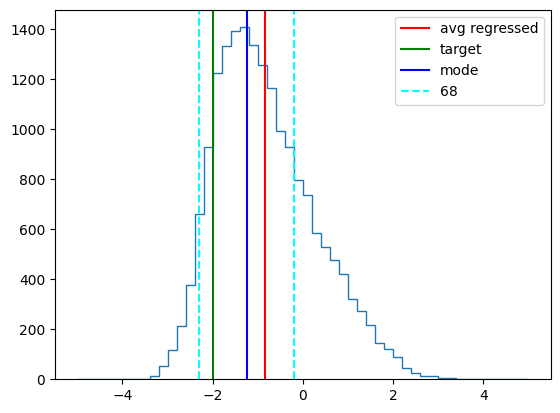

In [93]:
target = -2
mask = ((higgsCorrect.eta>(target-0.1))&(higgsCorrect.eta<(target+0.1))).to_numpy()

X = higgs_regr_CM[mask].eta.to_numpy()
mode, left, right = get_central_smallest_interval(X, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(-5,5), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg regressed")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

## Thad

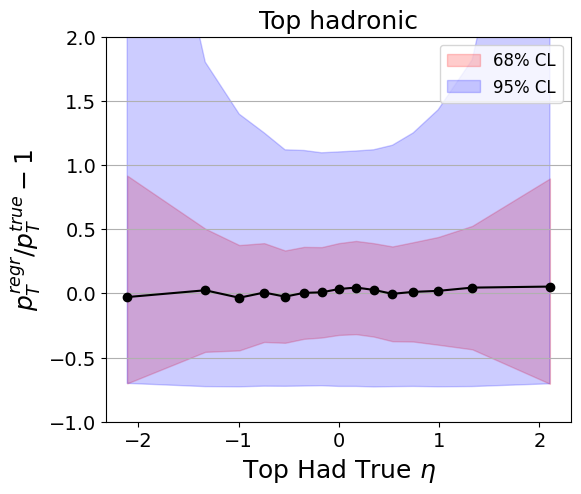

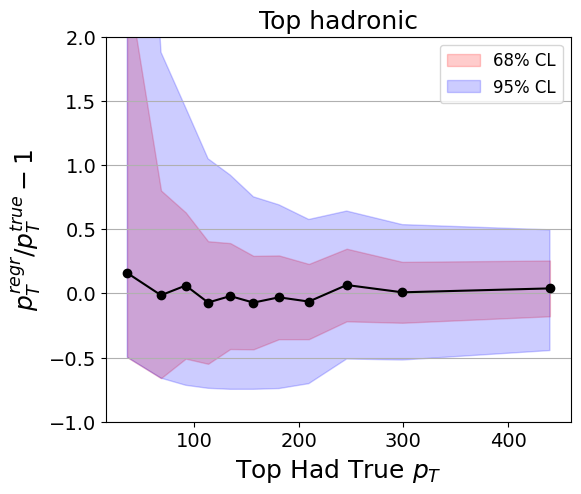

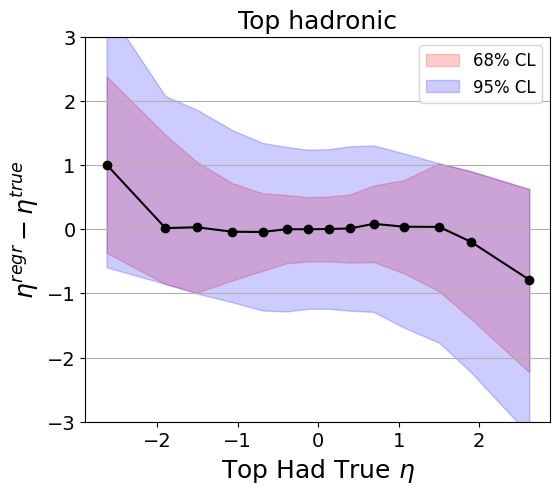

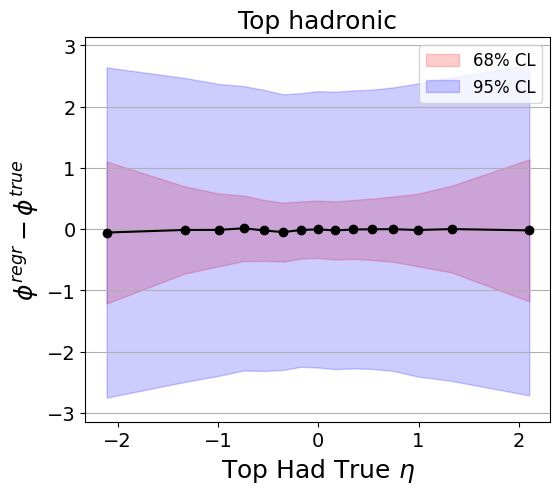

In [94]:
plot_diff_mode_quantile((thad_regr_CM.pt/ thadCorrect.pt  -1 ).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top hadronic') 

plot_diff_mode_quantile((thad_regr_CM.pt/ thadCorrect.pt  -1 ).to_numpy(), 
                        X=thadCorrect.pt.to_numpy(),  
                        cat_var=thadCorrect.pt.to_numpy(), 
                        bins=np.quantile(thadCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Had True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top hadronic')

plot_diff_mode_quantile((thad_regr_CM.eta - thadCorrect.eta ).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(thadCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Had True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top hadronic')

plot_diff_mode_quantile(thad_regr_CM.deltaphi(thadCorrect).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top hadronic') 

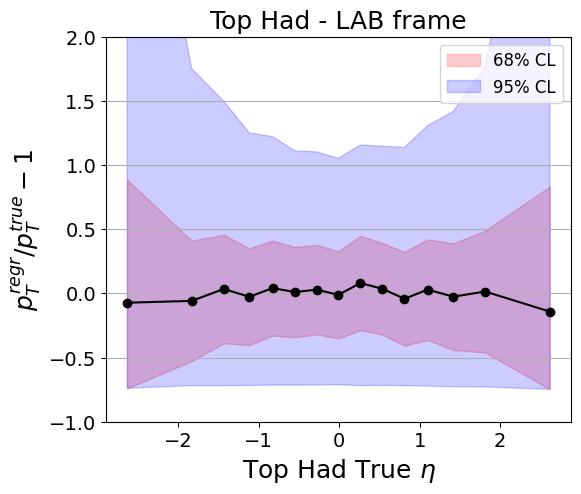

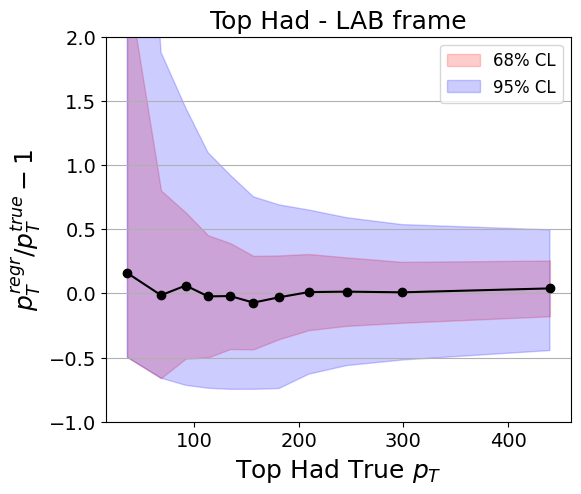

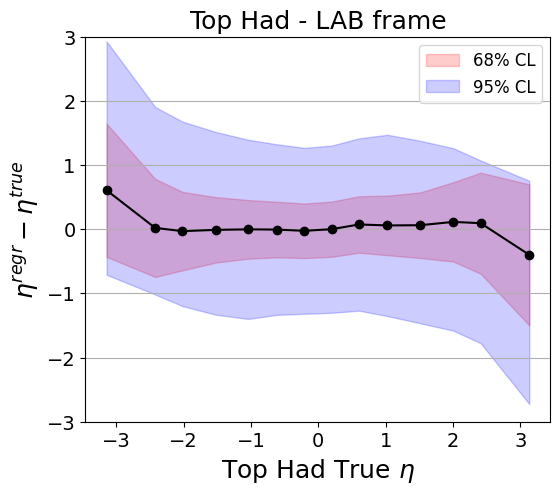

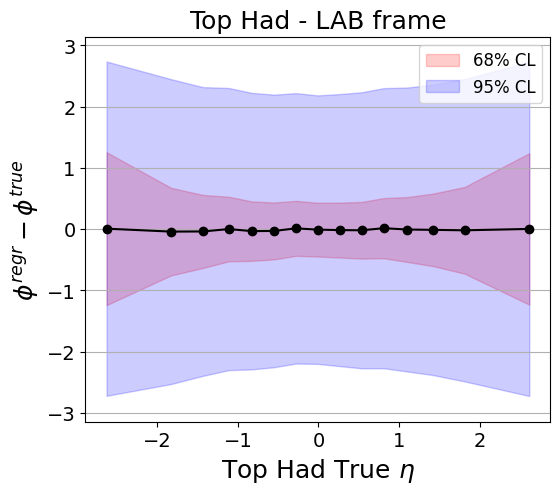

In [95]:
plot_diff_mode_quantile((thad_regr_lab.pt/ thadCorrect.pt  -1 ).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Had - LAB frame')

plot_diff_mode_quantile((thad_regr_lab.pt/ thadCorrect_lab.pt  -1 ).to_numpy(), 
                        X=thadCorrect_lab.pt.to_numpy(),  
                        cat_var=thadCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(thadCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Had True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Had - LAB frame')

plot_diff_mode_quantile((thad_regr_lab.eta - thadCorrect_lab.eta ).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Had True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top Had - LAB frame')

plot_diff_mode_quantile(thad_regr_lab.deltaphi(thadCorrect_lab).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top Had - LAB frame') 

## T lep

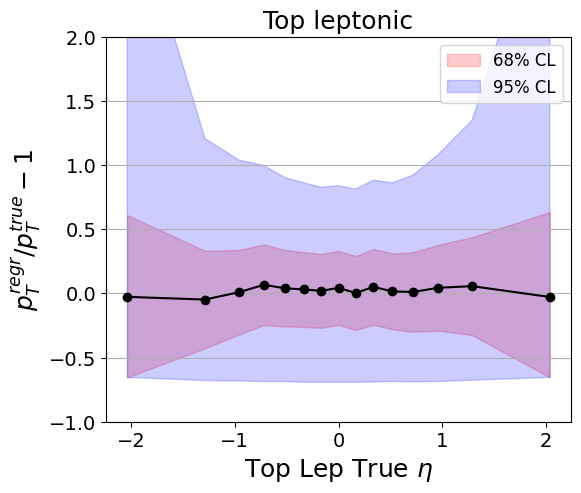

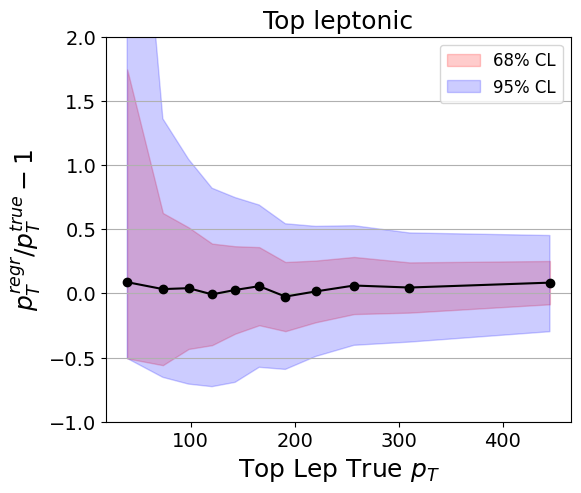

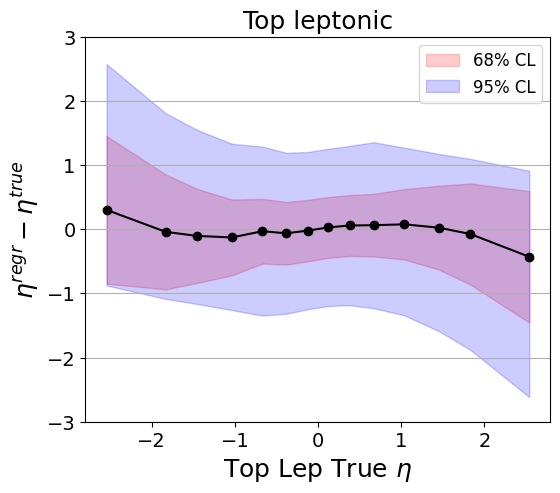

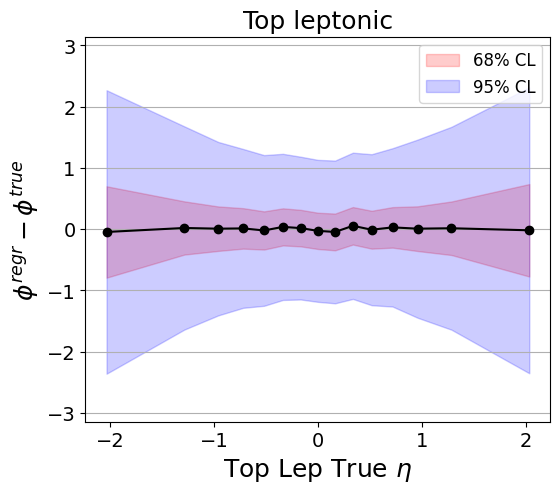

In [96]:
plot_diff_mode_quantile((tlep_regr_CM.pt/ tlepCorrect.pt  -1 ).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top leptonic') 

plot_diff_mode_quantile((tlep_regr_CM.pt/ tlepCorrect.pt  -1 ).to_numpy(), 
                        X=tlepCorrect.pt.to_numpy(),  
                        cat_var=tlepCorrect.pt.to_numpy(), 
                        bins=np.quantile(tlepCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Lep True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top leptonic')

plot_diff_mode_quantile((tlep_regr_CM.eta - tlepCorrect.eta ).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Lep True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top leptonic')

plot_diff_mode_quantile(tlep_regr_CM.deltaphi(tlepCorrect).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top leptonic') 

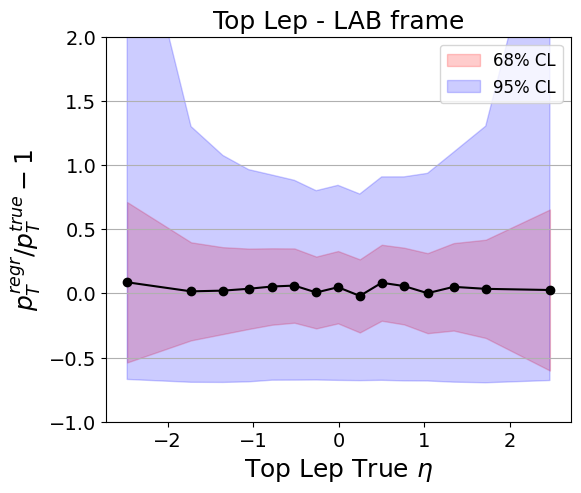

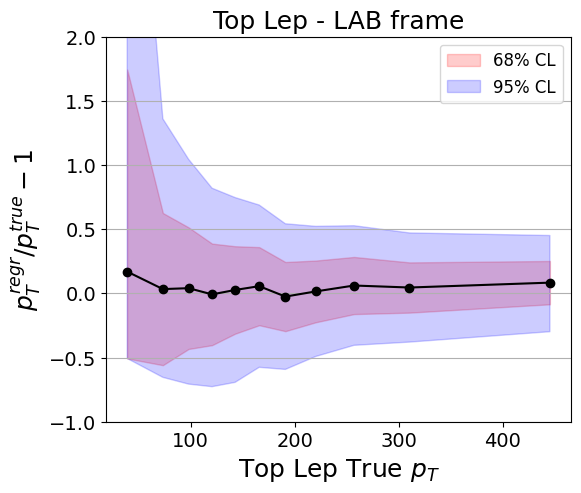

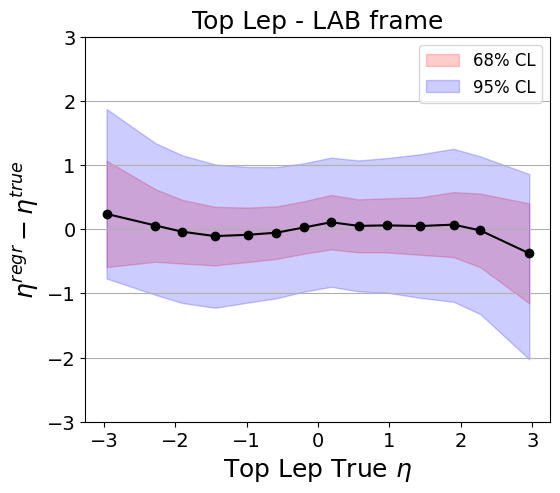

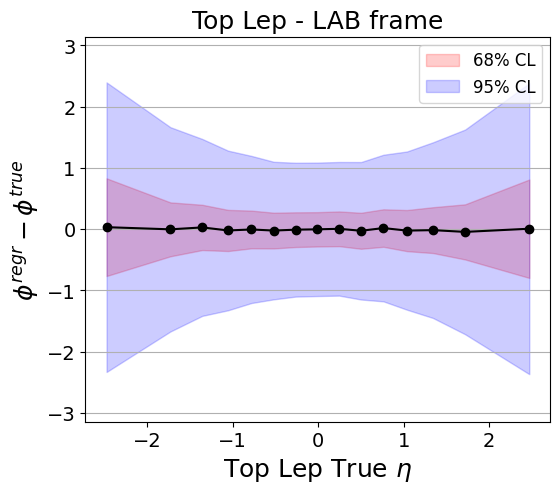

In [97]:
plot_diff_mode_quantile((tlep_regr_lab.pt/ tlepCorrect.pt  -1 ).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Lep - LAB frame')

plot_diff_mode_quantile((tlep_regr_lab.pt/ tlepCorrect_lab.pt  -1 ).to_numpy(), 
                        X=tlepCorrect_lab.pt.to_numpy(),  
                        cat_var=tlepCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(tlepCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Lep True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Lep - LAB frame')

plot_diff_mode_quantile((tlep_regr_lab.eta - tlepCorrect_lab.eta ).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Lep True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top Lep - LAB frame')

plot_diff_mode_quantile(tlep_regr_lab.deltaphi(tlepCorrect_lab).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top Lep - LAB frame') 

## Gluon

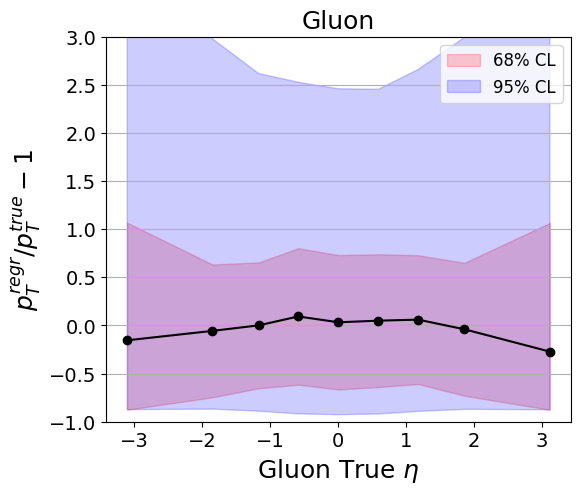

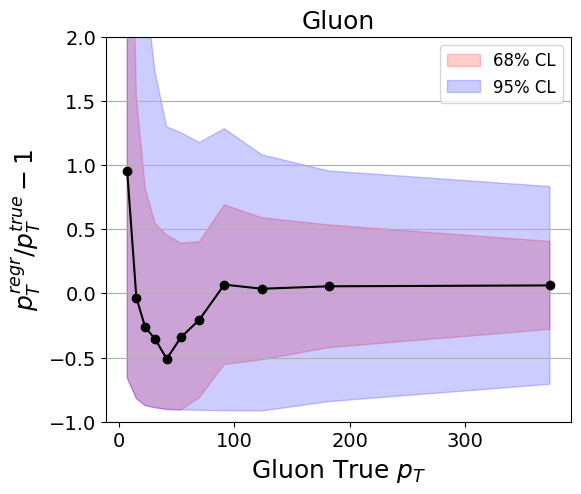

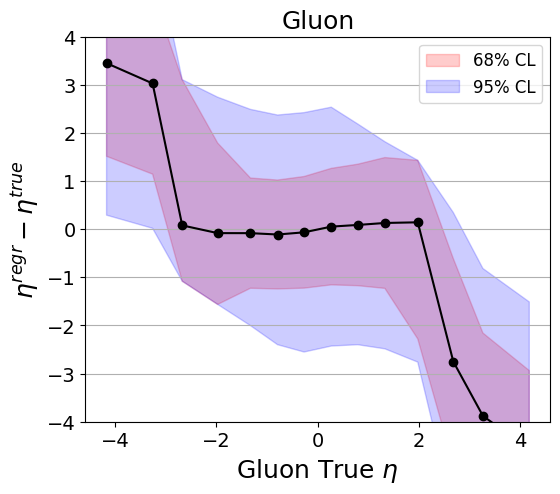

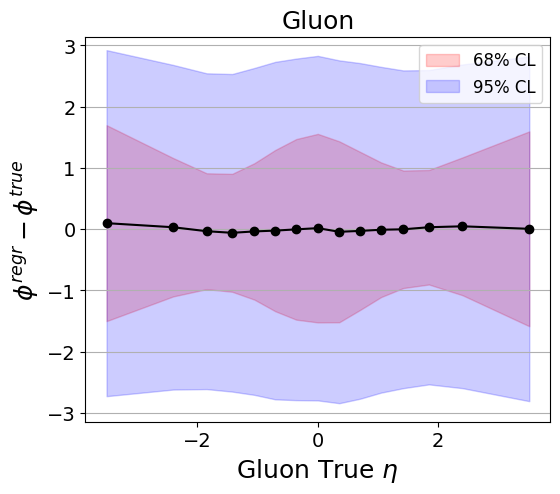

In [98]:
plot_diff_mode_quantile((isr_regr_CM.pt/ glISRCorrect.pt  -1 ).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), np.linspace(0,1,10)),
                        xlabel='Gluon True $\eta$', ylim=(-1,3),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon') 

plot_diff_mode_quantile((isr_regr_CM.pt/ glISRCorrect.pt  -1 ).to_numpy(), 
                        X=glISRCorrect.pt.to_numpy(),  
                        cat_var=glISRCorrect.pt.to_numpy(), 
                        bins=np.quantile(glISRCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Gluon True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon')

plot_diff_mode_quantile((isr_regr_CM.eta - glISRCorrect.eta ).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Gluon True $\eta$', ylim=(-4,4),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Gluon')

plot_diff_mode_quantile(isr_regr_CM.deltaphi(glISRCorrect).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Gluon') 

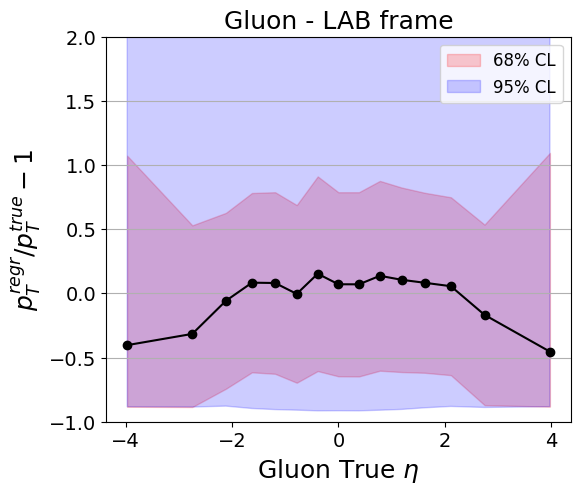

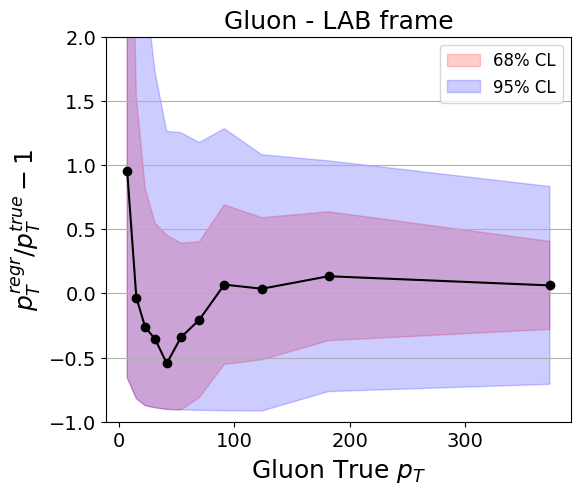

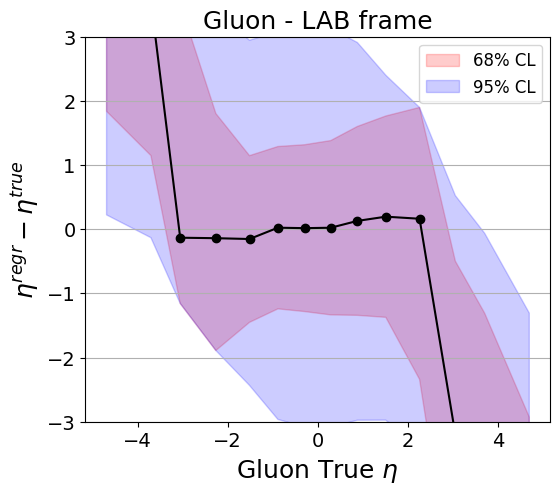

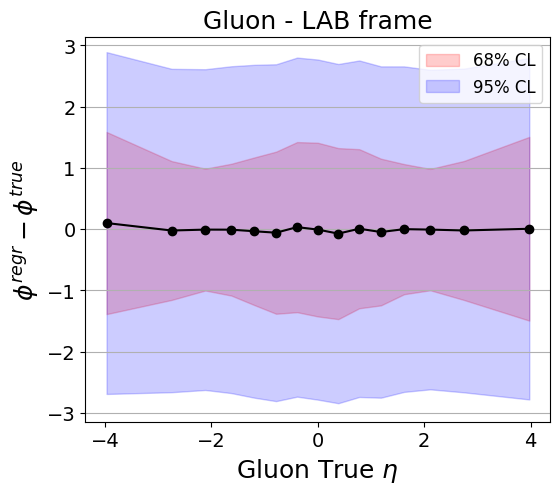

In [99]:
plot_diff_mode_quantile((isr_regr_lab.pt/ glISRCorrect_lab.pt  -1 ).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon - LAB frame')

plot_diff_mode_quantile((isr_regr_lab.pt/ glISRCorrect_lab.pt  -1 ).to_numpy(), 
                        X=glISRCorrect_lab.pt.to_numpy(),  
                        cat_var=glISRCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(glISRCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Gluon True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon - LAB frame')

plot_diff_mode_quantile((isr_regr_lab.eta - glISRCorrect_lab.eta ).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Gluon True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Gluon - LAB frame')

plot_diff_mode_quantile(isr_regr_lab.deltaphi(glISRCorrect_lab).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Gluon - LAB frame') 

## Boost

In [100]:
boost_true[:,3]

tensor([ -717.5827,   804.9993,  1065.0983,  -137.8012,  -142.2644,   648.0560,
        -1284.4086,   -38.2595,  -555.0604, -2773.4360,   560.6890,   102.4799,
            4.7607, -3257.8665, -1283.4043,    33.3500,   704.1931,  1395.6227,
          223.3458,    78.2795,  1172.0352,   732.6832,  -820.8189,  2246.8721,
        -1813.5701, -1349.6829, -1562.4285,  2477.2595,   292.0418, -2784.8855,
          -61.8525, -1846.8643,   449.7228,  -405.7913,  -996.5944,   -32.2218,
         1160.9144,  -942.7261,   174.4118,   195.9467,   940.8354,  1369.8292,
        -1304.3193,  -394.4349,   508.1472,  -898.9992,   206.9683,  1195.4174,
         -154.3398,   664.8674], device='cuda:0')

In [101]:
boost_regr[:,1]

tensor([-658.2746,  949.2159, 1250.0747,  ..., -638.9467, 1338.4487,
         561.3750])

ValueError: x and y must have the same length.

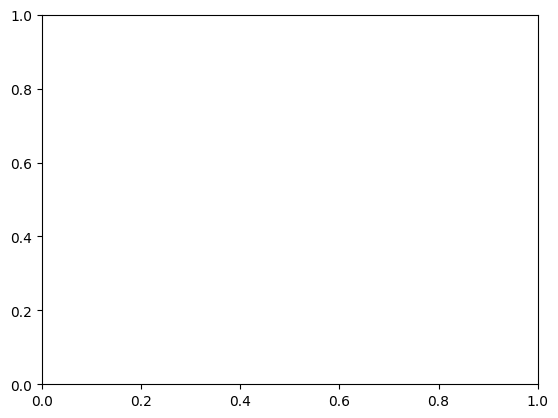

In [103]:
plt.hist2d(boost_true[:,3].cpu().numpy(), boost_regr[:,1].numpy(), bins=100, norm=LogNorm());

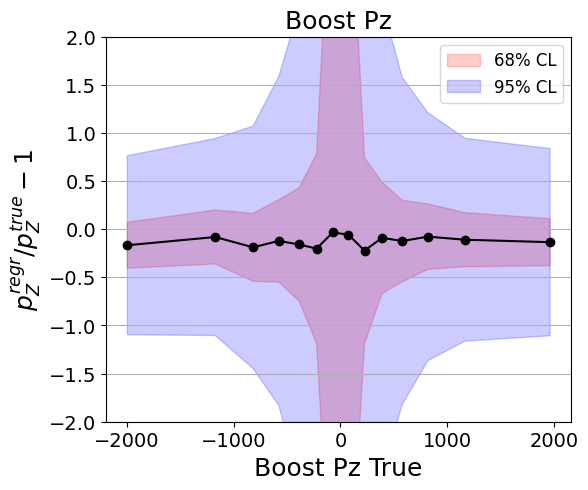

In [139]:
plot_diff_mode_quantile((boost_true[:,3]/ boost_regr[:,1]-1).numpy(), 
                        X=boost_regr[:,1].numpy(),  
                        cat_var=boost_regr[:,1].numpy(),  
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(boost_regr[:,1].numpy(), np.linspace(0,1,15)),
                        xlabel='Boost Pz True', ylim=(-2,2),
                    ylabel='$p_Z^{regr}/p_Z^{true} -1 $', title='Boost Pz')


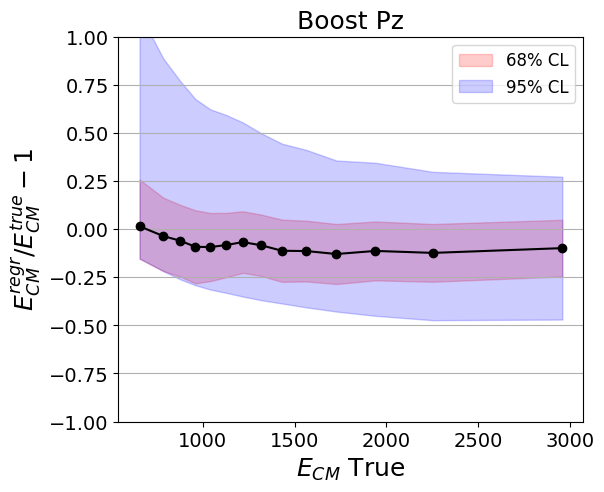

In [166]:
plot_diff_mode_quantile((boost_true[:,0]/ boost_regr[:,0]-1).numpy(), 
                        X=boost_regr[:,0].numpy(),  
                        cat_var=boost_regr[:,0].numpy(),  
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(boost_regr[:,0].numpy(), np.linspace(0,1,15)),
                        xlabel='$E_{CM}$ True', ylim=(-1,1),
                    ylabel='$E_{CM}^{regr}/E_{CM}^{true} -1 $', title='Boost Pz')


# Bias analysis for the sampling

In [8]:
import h5py
df = h5py.File("/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/flow_flow_sampling_v3c-sampling_DiagNormal_NoTransf6_NoBins40_DNN2_512/samples_40.hdf5")
df.keys()

<KeysViewHDF5 ['boost', 'flow_samples', 'logprob', 'part_CM_Epxpypz', 'part_lab_ptetaphi', 'ps']>

In [9]:
ps_samples = torch.from_numpy(df["flow_samples"][()]).to("cpu")

In [40]:
(higgs_regr_CM, thad_regr_CM, tlep_regr_CM, isr_regr_CM) = get_particle_awkward(torch.from_numpy(df["part_CM_Epxpypz"][()] )) # it is in the CM
boost_regr = torch.from_numpy(df['boost'][()])
boost_regr = boost_regr*log_std_boost.to("cpu") + log_mean_boost.to("cpu") 
boost_regr[:,0] = torch.exp(boost_regr[:,0]) - 1

x1true = (boost_parton[:,0,0]+boost_parton[:,0,3])/E_CM
x2true = (boost_parton[:,0,0]-boost_parton[:,0,3])/E_CM


In [33]:
# Need to unscale the particle in the lab
partons_lab = torch.from_numpy(df["part_lab_ptetaphi"][()])
partons_lab = partons_lab*log_std_parton_lab.to("cpu")  + log_mean_parton_lab.to("cpu") 
partons_lab[:,:,0] = torch.exp(partons_lab[:,:, 0]) - 1
(higgs_regr_lab, thad_regr_lab, tlep_regr_lab, isr_regr_lab) = get_particle_awkward_ptetaphi(partons_lab)

In [12]:
ps_samples.shape

torch.Size([1792125, 40, 10])

In [17]:
ps_unscaled = torch.sigmoid(ps_samples[:,0,:]*scale_ps.to("cpu") + mean_ps.to("cpu")).squeeze()
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_unscaled)
Hs, t1s, t2s, isrs = get_particle_awkward(momenta[:,2:].cpu())

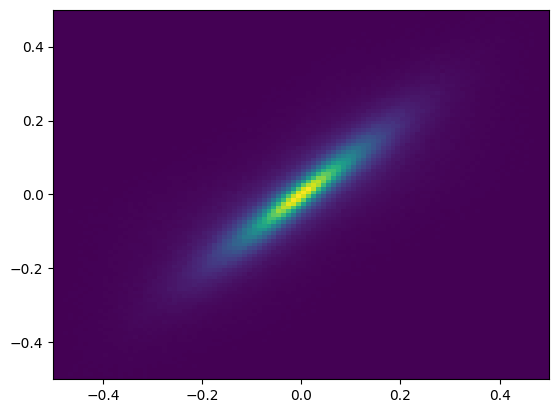

In [57]:
plt.hist2d((x1true-x2true).numpy(),(x1pp-x2pp).numpy(), bins=100, range=((-0.5,0.5),(-0.5,0.5)),
          );

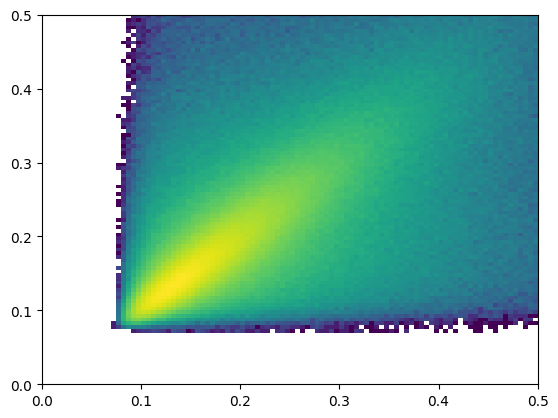

In [60]:
plt.hist2d((x1true+x2true).numpy(),(x1pp+x2pp).numpy(), bins=100, range=((0,0.5),(0,0.5)),
          norm=LogNorm());

Text(0.5, 1.0, 'ISR')

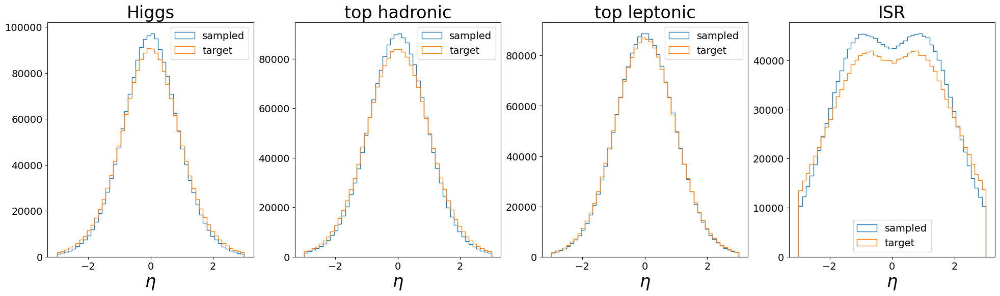

In [28]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(Hs.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[0].hist(higgsCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$\eta$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(t1s.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[1].hist(thadCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$\eta$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(t2s.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[2].hist(tlepCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$\eta$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isrs.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[3].hist(glISRCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$\eta$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

Text(0.5, 1.0, 'ISR')

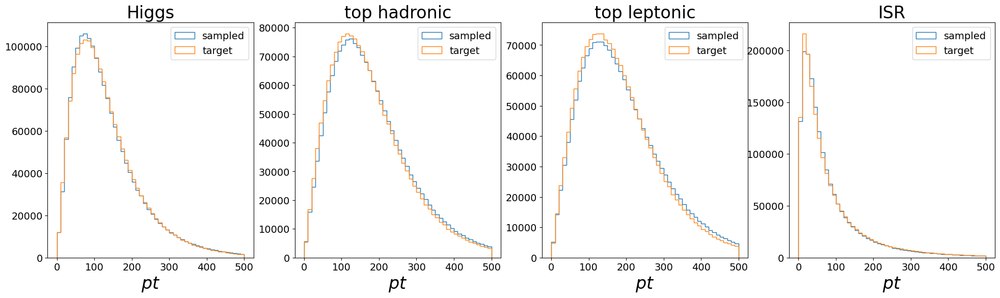

In [29]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(Hs.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[0].hist(higgsCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$pt$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(t1s.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[1].hist(thadCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$pt$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(t2s.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[2].hist(tlepCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$pt$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isrs.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[3].hist(glISRCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$pt$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

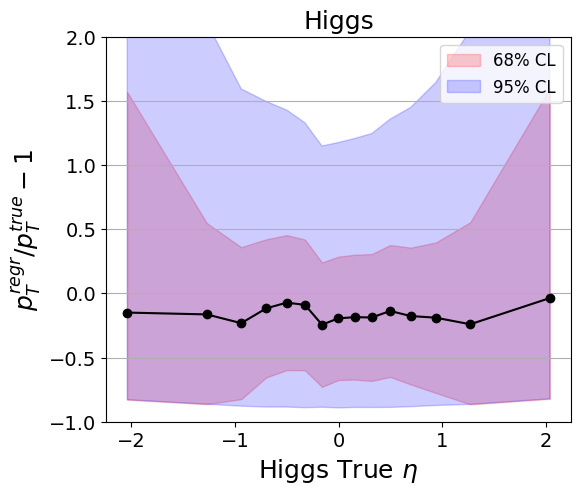

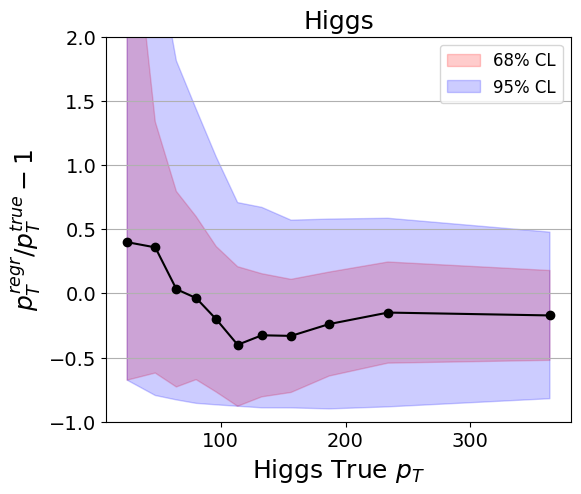

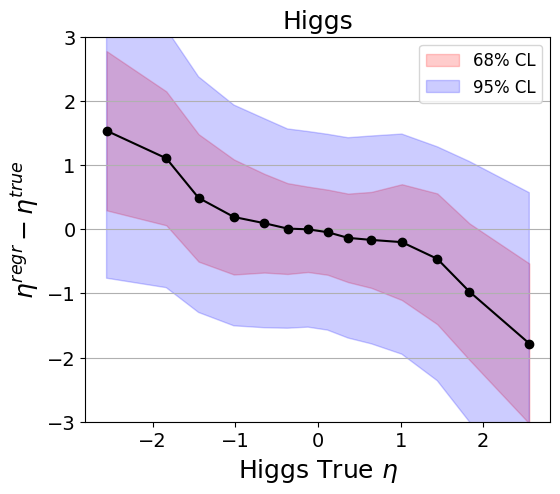

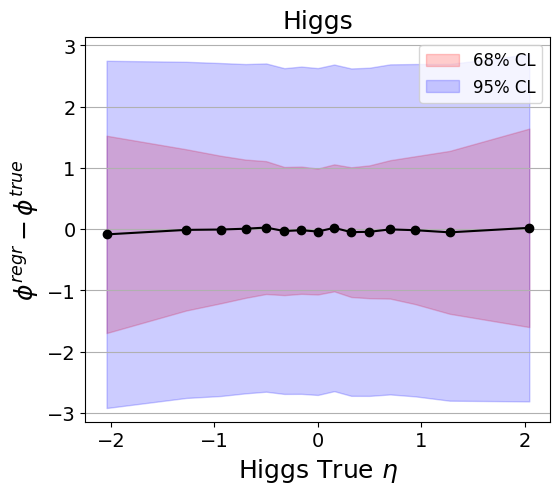

In [36]:
plot_diff_mode_quantile((Hs.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((Hs.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.pt.to_numpy(),  
                        cat_var=higgsCorrect.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((Hs.eta - higgsCorrect.eta ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(Hs.deltaphi(higgsCorrect).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

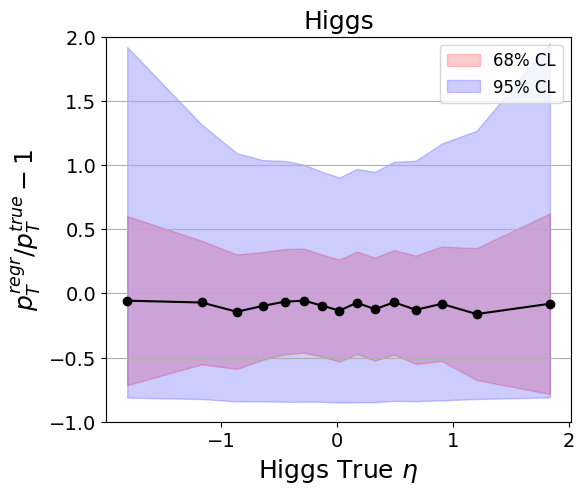

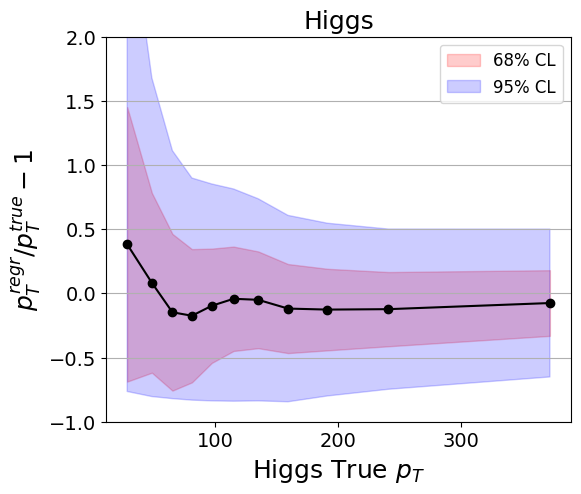

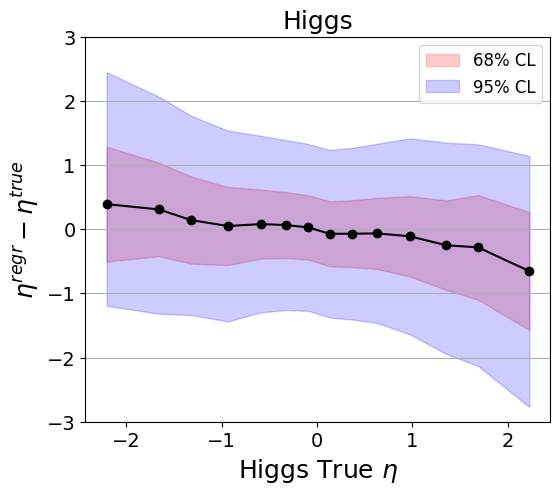

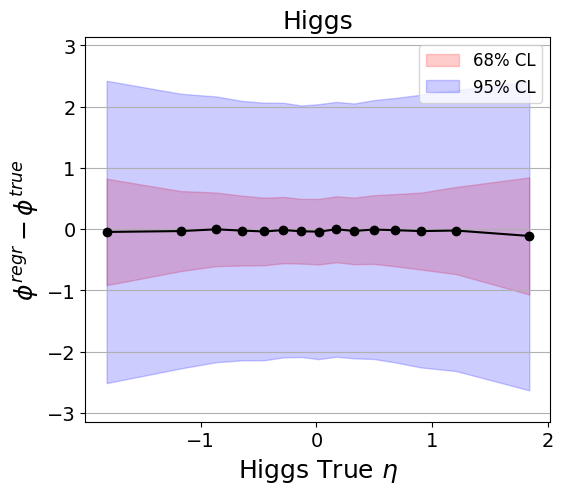

In [34]:
plot_diff_mode_quantile((Hs.pt/ higgs_regr_CM.pt  -1 ).to_numpy(), 
                        X=higgs_regr_CM.eta.to_numpy(),  
                        cat_var=higgs_regr_CM.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgs_regr_CM.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((Hs.pt/ higgs_regr_CM.pt  -1 ).to_numpy(), 
                        X=higgs_regr_CM.pt.to_numpy(),  
                        cat_var=higgs_regr_CM.pt.to_numpy(), 
                        bins=np.quantile(higgs_regr_CM.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((Hs.eta - higgs_regr_CM.eta ).to_numpy(), 
                        X=higgs_regr_CM.eta.to_numpy(),  
                        cat_var=higgs_regr_CM.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgs_regr_CM.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(Hs.deltaphi(higgs_regr_CM).to_numpy(), 
                        X=higgs_regr_CM.eta.to_numpy(),  
                        cat_var=higgs_regr_CM.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgs_regr_CM.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

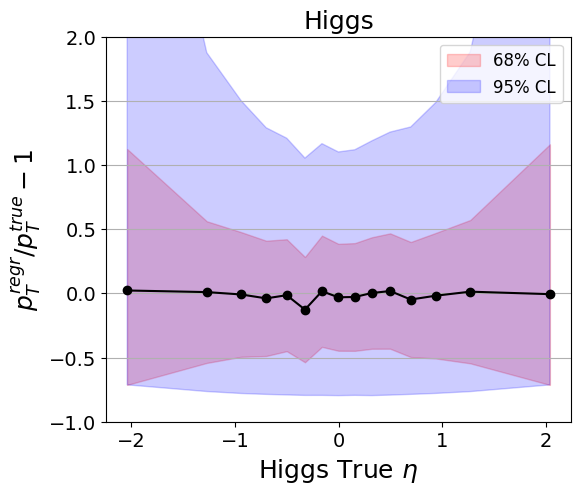

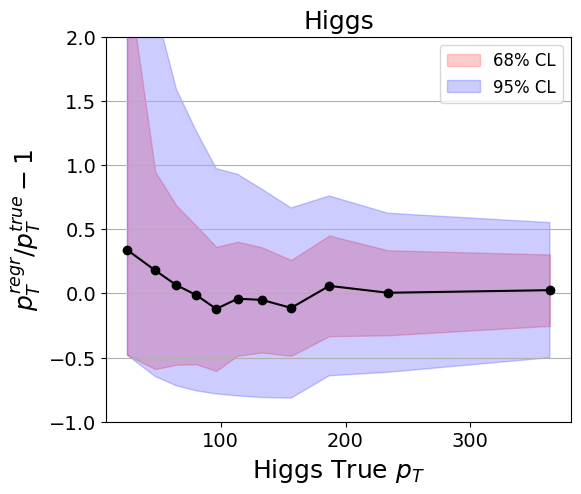

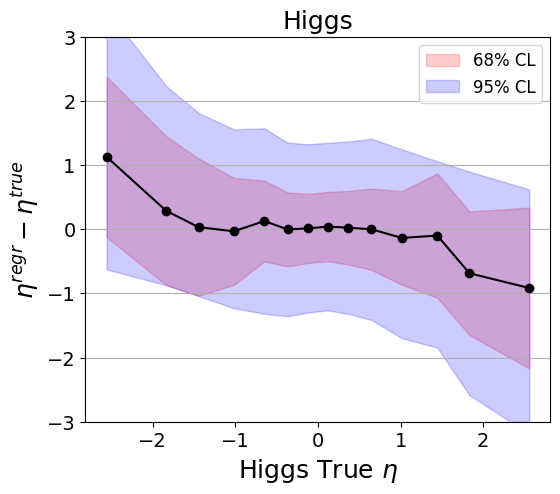

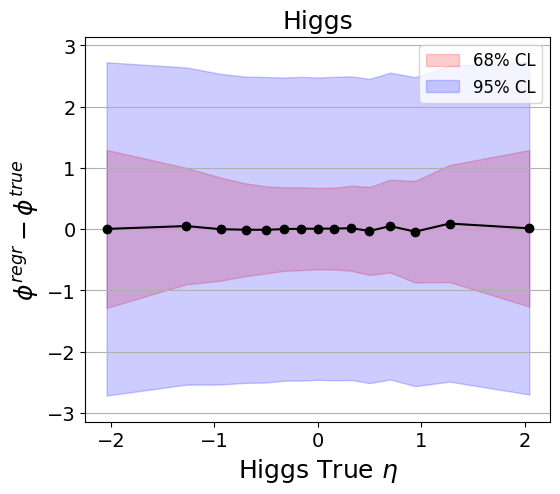

In [35]:
plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.pt.to_numpy(),  
                        cat_var=higgsCorrect.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((higgs_regr_CM.eta - higgsCorrect.eta ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(higgs_regr_CM.deltaphi(higgsCorrect).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

## Multisample avg

In [40]:
outputs = []
batch_size = 10000
Nsamples = ps_samples.shape[1]

for b in track(range(150)):
    ps_unscaled = torch.sigmoid(ps_samples[b*batch_size:(b+1)*batch_size]*scale_ps.to("cpu") + mean_ps.to("cpu"))
    ps_new_flat = ps_unscaled.flatten(0, 1)
    momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
    x1pp = x1pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
    x2pp = x2pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
    momenta = momenta.reshape(-1,ps_unscaled.shape[1], 6, 4)#.transpose(1, 0)
    
    Nevents= ps_samples.shape[0]

    H, t1, t2, isr = (higgsCorrect[b*batch_size:(b+1)*batch_size], 
    thadCorrect[b*batch_size:(b+1)*batch_size],
    tlepCorrect[b*batch_size:(b+1)*batch_size], glISRCorrect[b*batch_size:(b+1)*batch_size])
    
    H, t1, t2, isr = get_particle_awkward(dataCM[b*batch_size:(b+1)*batch_size].cpu())
    
    Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta.cpu())

    
    Hr, t1r, t2r, isrr = (higgs_regr_CM[b*batch_size:(b+1)*batch_size], 
    thad_regr_CM[b*batch_size:(b+1)*batch_size],
    tlep_regr_CM[b*batch_size:(b+1)*batch_size], isr_regr_CM[b*batch_size:(b+1)*batch_size])

    
    x1true = (boost_parton[b*batch_size:(b+1)*batch_size,0,0]+boost_parton[b*batch_size:(b+1)*batch_size,0,3])/E_CM
    x2true = (boost_parton[b*batch_size:(b+1)*batch_size,0,0]-boost_parton[b*batch_size:(b+1)*batch_size,0,3])/E_CM


    diff_H_pt = get_diff(H.pt, Hs.pt, Nsamples)
    diff_H_eta = get_diff(H.eta, Hs.eta, Nsamples)
    diff_H_phi = get_diff(H.phi, Hs.phi, Nsamples)

    diff_t1_pt = get_diff(t1.pt, t1s.pt, Nsamples)
    diff_t1_eta = get_diff(t1.eta, t1s.eta, Nsamples)
    diff_t1_phi = get_diff(t1.phi, t1s.phi, Nsamples)

    diff_t2_pt = get_diff(t2.pt, t2s.pt, Nsamples)
    diff_t2_eta = get_diff(t2.eta, t2s.eta, Nsamples)
    diff_t2_phi = get_diff(t2.phi, t2s.phi, Nsamples)

    diff_isr_pt = get_diff(isr.pt, isrs.pt, Nsamples)
    diff_isr_eta = get_diff(isr.eta, isrs.eta, Nsamples)
    diff_isr_phi = get_diff(isr.phi, isrs.phi, Nsamples)

    diff_H_pt_regr = get_diff(Hr.pt, Hs.pt, Nsamples)
    diff_H_eta_regr = get_diff(Hr.eta, Hs.eta, Nsamples)
    diff_H_phi_regr = get_diff(Hr.phi, Hs.phi, Nsamples)

    diff_t1_pt_regr = get_diff(t1r.pt, t1s.pt, Nsamples)
    diff_t1_eta_regr = get_diff(t1r.eta, t1s.eta, Nsamples)
    diff_t1_phi_regr = get_diff(t1r.phi, t1s.phi, Nsamples)

    diff_t2_pt_regr = get_diff(t2r.pt, t2s.pt, Nsamples)
    diff_t2_eta_regr = get_diff(t2r.eta, t2s.eta, Nsamples)
    diff_t2_phi_regr = get_diff(t2r.phi, t2s.phi, Nsamples)

    diff_isr_pt_regr = get_diff(isrr.pt, isrs.pt, Nsamples)
    diff_isr_eta_regr = get_diff(isrr.eta, isrs.eta, Nsamples)
    diff_isr_phi_regr = get_diff(isrr.phi, isrs.phi, Nsamples)

    out = {

        "H_pt": ak.to_numpy(H.pt),
        "H_eta": ak.to_numpy(H.eta),
        "H_phi": ak.to_numpy(H.phi),
        "t1_pt": ak.to_numpy(t1.pt),
        "t1_eta": ak.to_numpy(t1.eta),
        "t1_phi": ak.to_numpy(t1.phi),
        "t2_pt": ak.to_numpy(t2.pt),
        "t2_eta": ak.to_numpy(t2.eta),
        "t2_phi": ak.to_numpy(t2.phi),
        "isr_pt": ak.to_numpy(isr.pt),
        "isr_eta": ak.to_numpy(isr.eta),
        "isr_phi": ak.to_numpy(isr.phi),
        #"Njets": mask_jets.sum(1).cpu().numpy(),
        "x1":  x1true.cpu().numpy(),
        "x2":  x2true.cpu().numpy(),

        
        "delta_x1": (x1pp - x1true).transpose(1,0).nanmean(1).cpu().numpy(),
        "delta_x2": (x1pp - x1true).transpose(1,0).nanmean(1).cpu().numpy(),

        #"sigma_x1": x1pp.std(1).cpu().numpy(),
        #"sigma_x2":  x2pp.std(1).cpu().numpy(),
        
        "delta_H_pt": diff_H_pt.nanmean(1),
        "delta_H_eta": diff_H_eta.nanmean(1),
        "delta_H_phi": diff_H_phi.nanmean(1),
        
        "delta_t1_pt": diff_t1_pt.nanmean(1),
        "delta_t1_eta": diff_t1_eta.nanmean(1),
        "delta_t1_phi": diff_t1_phi.nanmean(1),
        
        "delta_t2_pt": diff_t2_pt.nanmean(1),
        "delta_t2_eta": diff_t2_eta.nanmean(1),
        "delta_t2_phi": diff_t2_phi.nanmean(1),

        "delta_isr_pt": diff_isr_pt.nanmean(1),
        "delta_isr_eta": diff_isr_eta.nanmean(1),
        "delta_isr_phi": diff_isr_phi.nanmean(1),

        "delta_H_pt_regr": diff_H_pt_regr.nanmean(1),
        "delta_H_eta_regr": diff_H_eta_regr.nanmean(1),
        "delta_H_phi_regr": diff_H_phi_regr.nanmean(1),
        
        "delta_t1_pt_regr": diff_t1_pt_regr.nanmean(1),
        "delta_t1_eta_regr": diff_t1_eta_regr.nanmean(1),
        "delta_t1_phi_regr": diff_t1_phi_regr.nanmean(1),
        
        "delta_t2_pt_regr": diff_t2_pt_regr.nanmean(1),
        "delta_t2_eta_regr": diff_t2_eta_regr.nanmean(1),
        "delta_t2_phi_regr": diff_t2_phi_regr.nanmean(1),

        "delta_isr_pt_regr": diff_isr_pt_regr.nanmean(1),
        "delta_isr_eta_regr": diff_isr_eta_regr.nanmean(1),
        "delta_isr_phi_regr": diff_isr_phi_regr.nanmean(1),

        "sigma_H_pt": get_std(Hs.pt),
        "sigma_H_eta": get_std(Hs.eta),
        "sigma_H_phi": get_std(Hs.phi),

        "sigma_t1_pt": get_std(t1s.pt),
        "sigma_t1_eta": get_std(t1s.eta),
        "sigma_t1_phi": get_std(t1s.phi),
        
        "sigma_t2_pt": get_std(t2s.pt),
        "sigma_t2_eta": get_std(t2s.eta),
        "sigma_t2_phi": get_std(t2s.phi),

        "sigma_isr_pt": get_std(isrs.pt),
        "sigma_isr_eta": get_std(isrs.eta),
        "sigma_isr_phi": get_std(isrs.phi),}
    outputs.append(out)

Output()

In [41]:
total = {}

for k in outputs[0].keys():
    if k in ["sigma_x1", "sigma_x2", "x1", "x2"]: continue
    total[k] = np.stack([v[k] for v in outputs],0).flatten()

df = pd.DataFrame(total) 
df.to_csv("bias_analysis_dump_flow_v3c-sampling.csv", index=False,sep=";")

In [12]:
df = pd.read_csv("bias_analysis_dump_flow_v3c-sampling.csv", sep=";")

In [42]:
def plot_results(df, var, xrange=None, xrange2=None):
    f, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=100)
    axs[0].hist(df[f"delta_{var}"], bins=100, range=xrange if xrange else None);
    axs[1].hist(df[f"sigma_{var}"], bins=100, range=xrange2 if xrange2 else None);
    axs[0].set_xlabel(f"delta_{var}")
    axs[1].set_xlabel(f"sigma_{var}")
    f.show()

/tmp/ipykernel_13332/991933038.py:7: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  f.show()


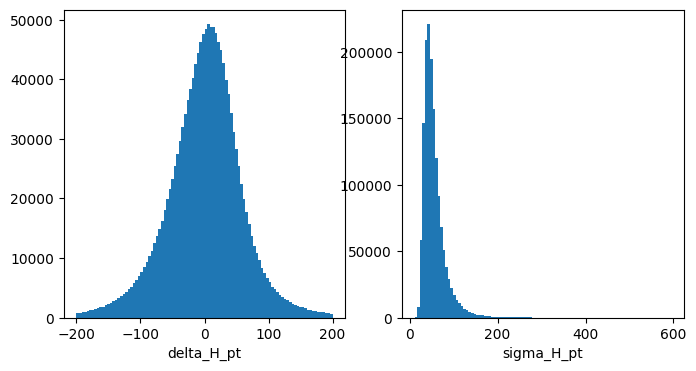

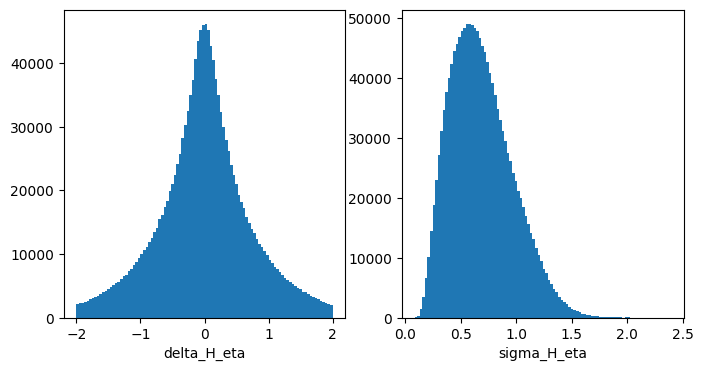

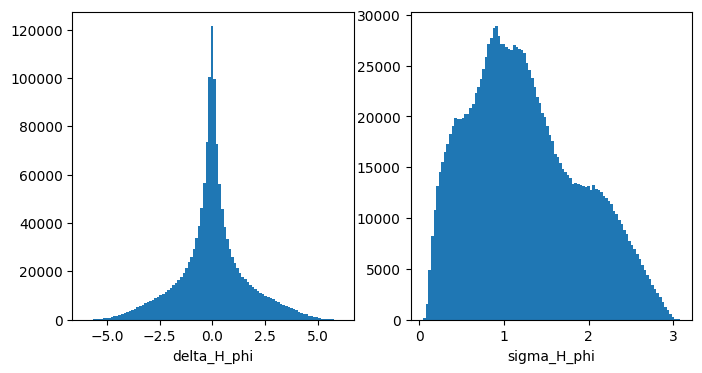

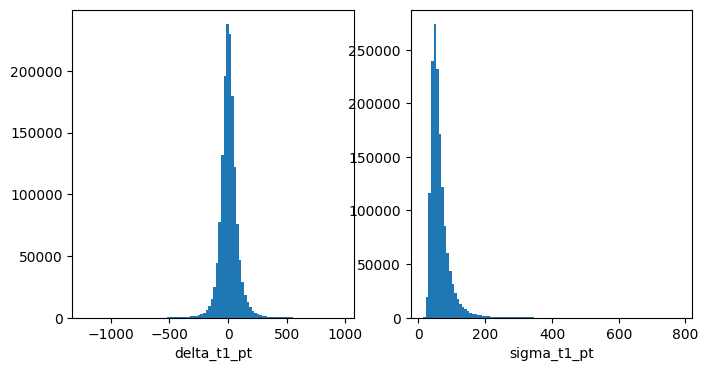

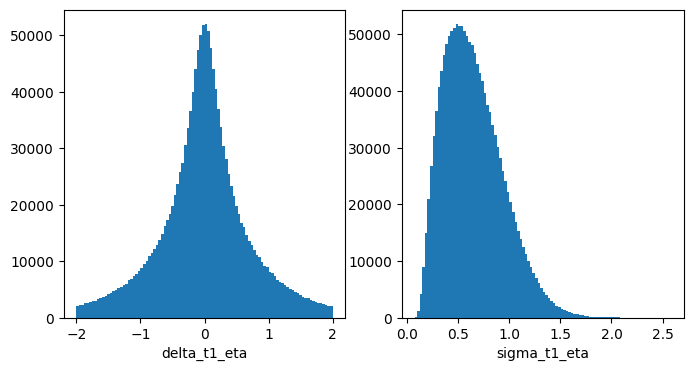

...

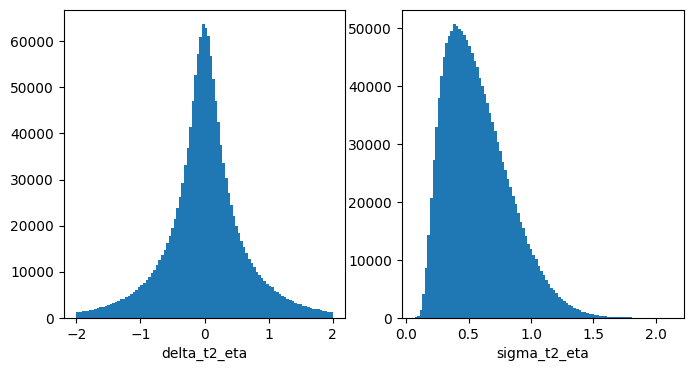

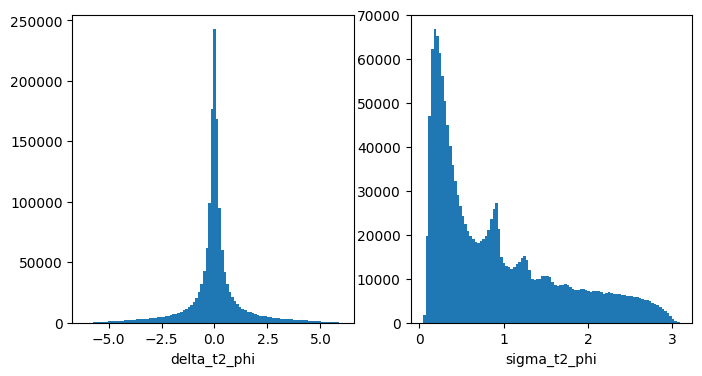

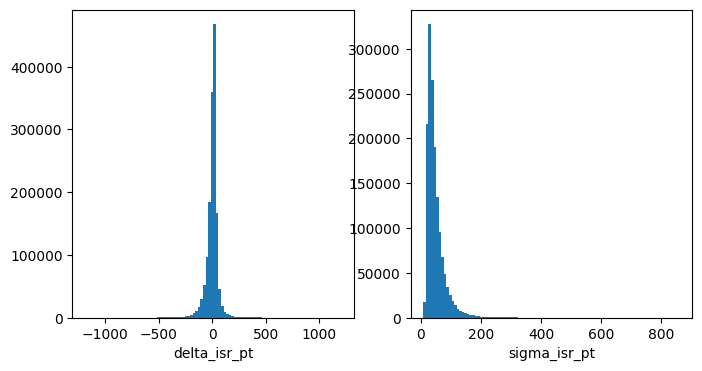

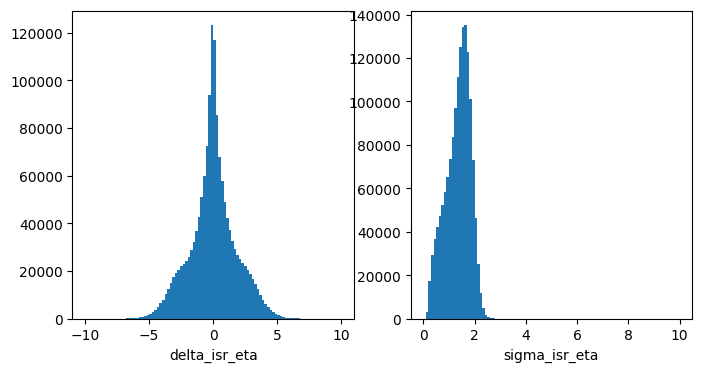

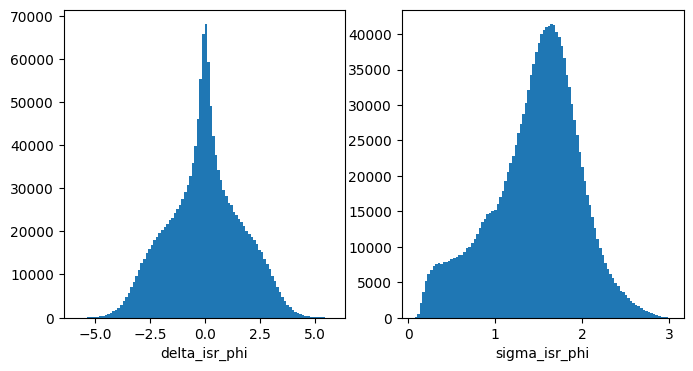

In [43]:
plot_results(df, "H_pt", xrange=(-200,200))
plot_results(df, "H_eta", xrange=(-2,2))
plot_results(df, "H_phi")
plot_results(df, "t1_pt")
plot_results(df, "t1_eta", xrange=(-2,2))
plot_results(df, "t1_phi")
plot_results(df, "t2_pt")
plot_results(df, "t2_eta",xrange=(-2,2))
plot_results(df, "t2_phi")
plot_results(df, "isr_pt")
plot_results(df, "isr_eta", xrange=(-10,10), xrange2=(0, 10))
plot_results(df, "isr_phi")

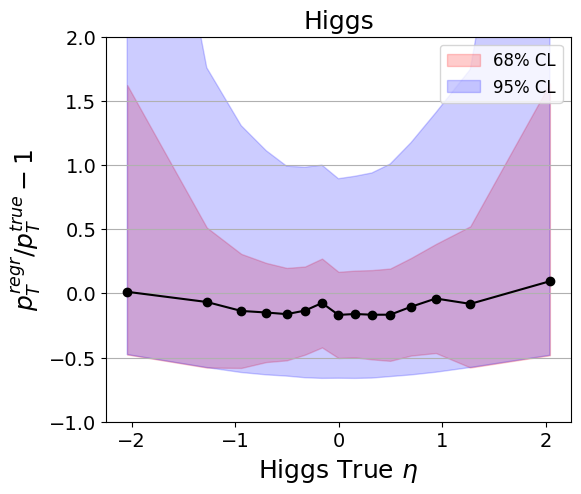

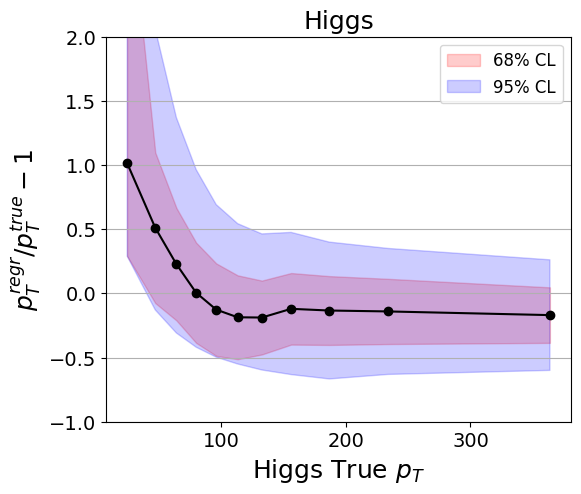

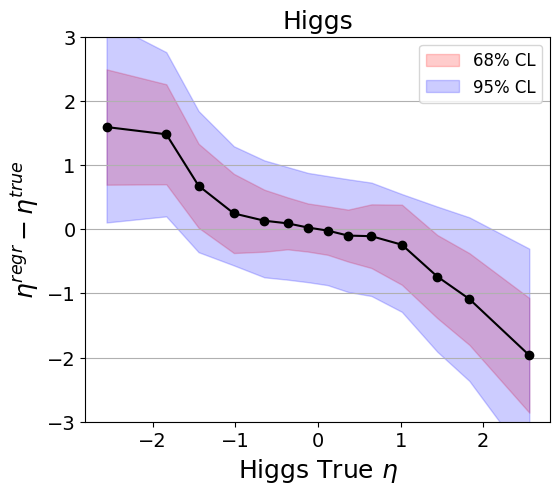

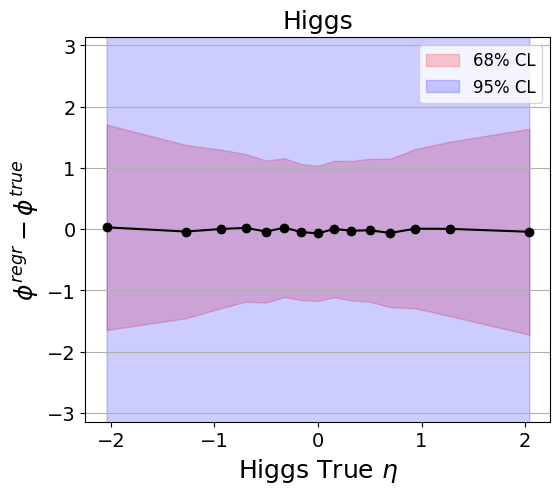

In [44]:
plot_diff_mode_quantile((df.delta_H_pt/df.H_pt).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.H_eta.values, np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((df.delta_H_pt/df.H_pt).values, 
                        X=df.H_pt.values,  
                        cat_var=df.H_pt.values, 
                        bins=np.quantile(df.H_pt.values, np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((df.delta_H_eta).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(df.H_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(df.delta_H_phi.values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.H_eta.values, np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

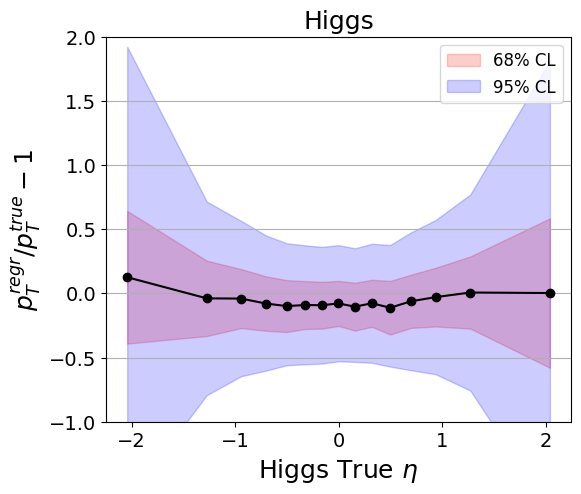

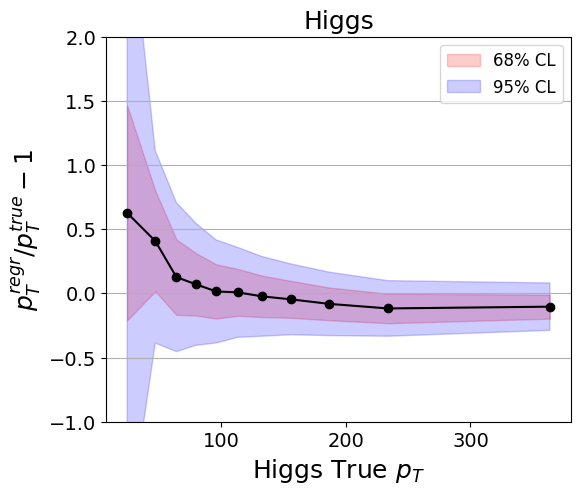

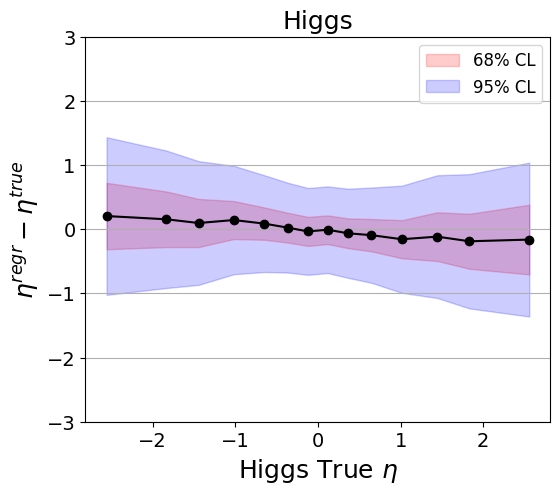

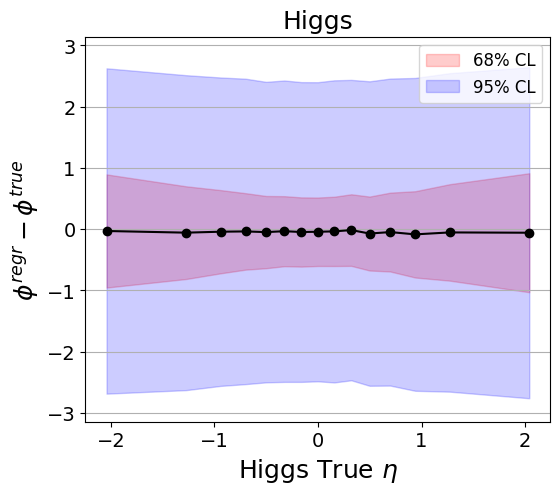

In [45]:
plot_diff_mode_quantile((df.delta_H_pt_regr/df.H_pt).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.H_eta.values, np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((df.delta_H_pt_regr/df.H_pt).values, 
                        X=df.H_pt.values,  
                        cat_var=df.H_pt.values, 
                        bins=np.quantile(df.H_pt.values, np.linspace(0,1,12)),
                        xlabel='Higgs True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Higgs')

plot_diff_mode_quantile((df.delta_H_eta_regr).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(df.H_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs')

plot_diff_mode_quantile(df.delta_H_phi_regr.values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.H_eta.values, np.linspace(0,1,16)),
                        xlabel='Higgs True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

In [234]:
plt.hist(df.delta_H_pt[df.H_pt<30], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>30)&(df.H_pt<50)], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>50)&(df.H_pt<70)], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>100)&(df.H_pt<110)], bins=100, histtype="step");

AttributeError: 'File' object has no attribute 'delta_H_pt'

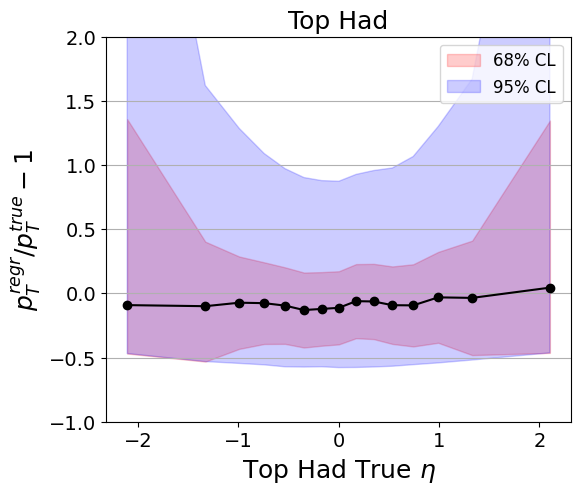

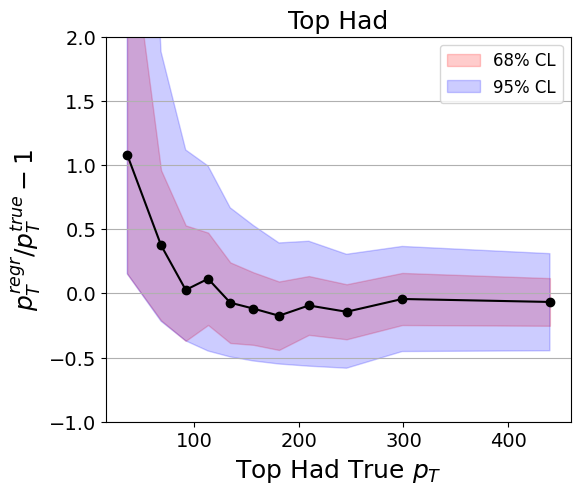

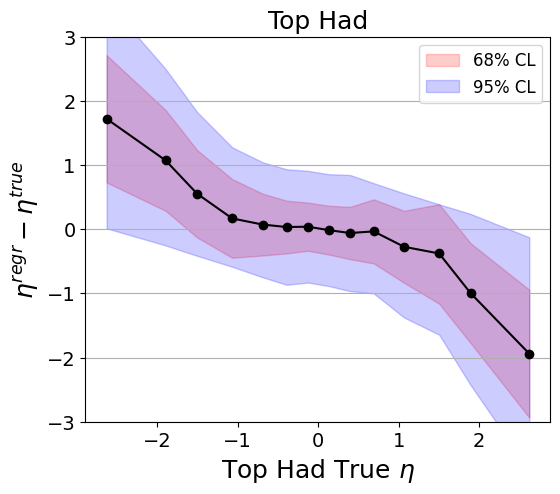

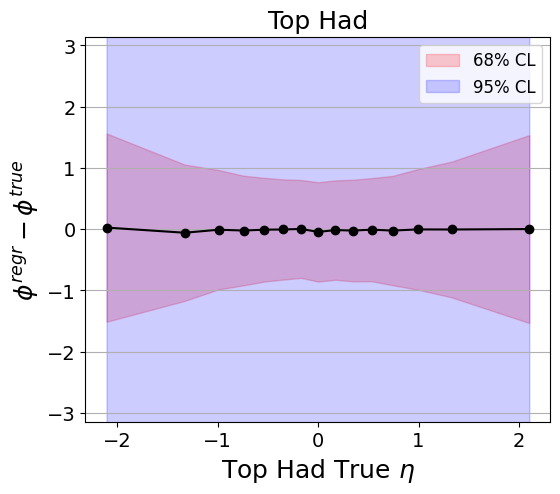

In [126]:
plot_diff_mode_quantile((df.delta_t1_pt/df.t1_pt).values, 
                        X=df.t1_eta.values,  
                        cat_var=df.t1_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.t1_eta.values, np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Had')

plot_diff_mode_quantile((df.delta_t1_pt/df.t1_pt).values, 
                        X=df.t1_pt.values,  
                        cat_var=df.t1_pt.values, 
                        bins=np.quantile(df.t1_pt.values, np.linspace(0,1,12)),
                        xlabel='Top Had True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Had')

plot_diff_mode_quantile((df.delta_t1_eta).values, 
                        X=df.t1_eta.values,  
                        cat_var=df.t1_eta.values, 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(df.t1_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Had True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top Had')

plot_diff_mode_quantile(df.delta_t1_phi.values, 
                        X=df.t1_eta.values,  
                        cat_var=df.t1_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.t1_eta.values, np.linspace(0,1,16)),
                        xlabel='Top Had True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top Had') 

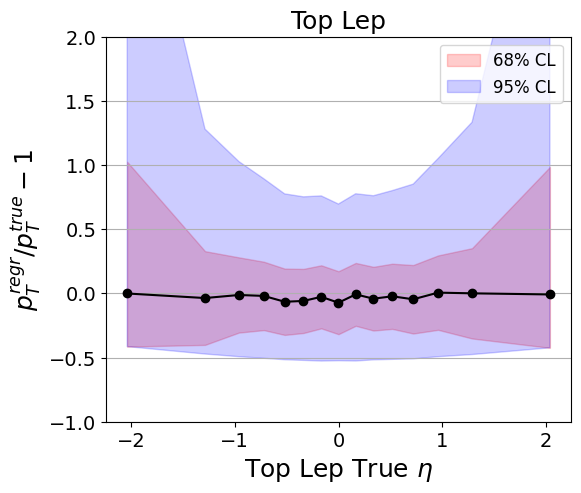

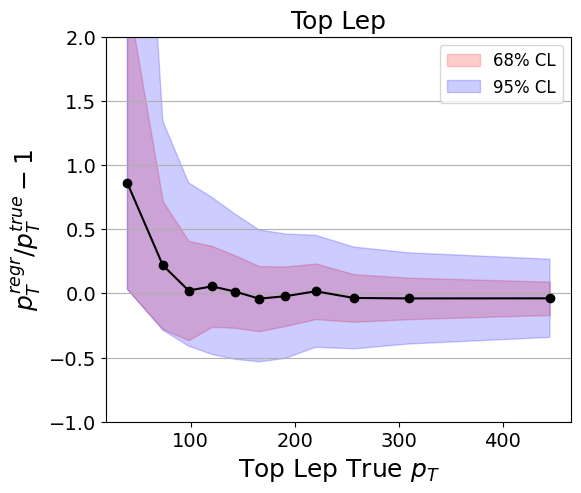

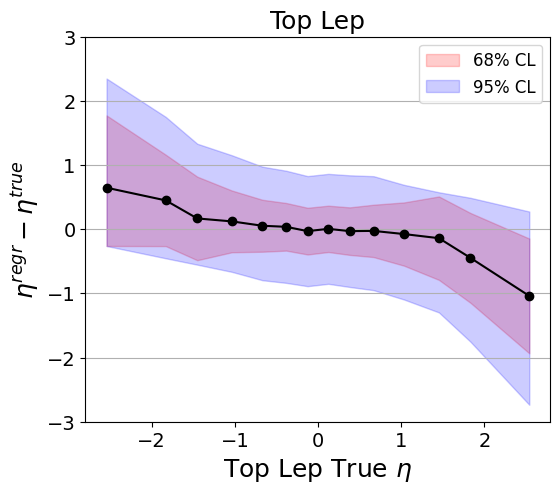

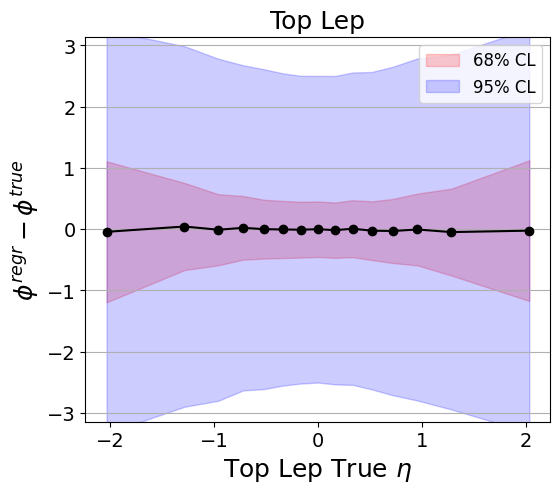

In [129]:
plot_diff_mode_quantile((df.delta_t2_pt/df.t2_pt).values, 
                        X=df.t2_eta.values,  
                        cat_var=df.t2_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.t2_eta.values, np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Lep')

plot_diff_mode_quantile((df.delta_t2_pt/df.t2_pt).values, 
                        X=df.t2_pt.values,  
                        cat_var=df.t2_pt.values, 
                        bins=np.quantile(df.t2_pt.values, np.linspace(0,1,12)),
                        xlabel='Top Lep True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Top Lep')

plot_diff_mode_quantile((df.delta_t2_eta).values, 
                        X=df.t2_eta.values,  
                        cat_var=df.t2_eta.values, 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(df.t2_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Lep True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Top Lep')

plot_diff_mode_quantile(df.delta_t2_phi.values, 
                        X=df.t2_eta.values,  
                        cat_var=df.t2_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.t2_eta.values, np.linspace(0,1,16)),
                        xlabel='Top Lep True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Top Lep') 

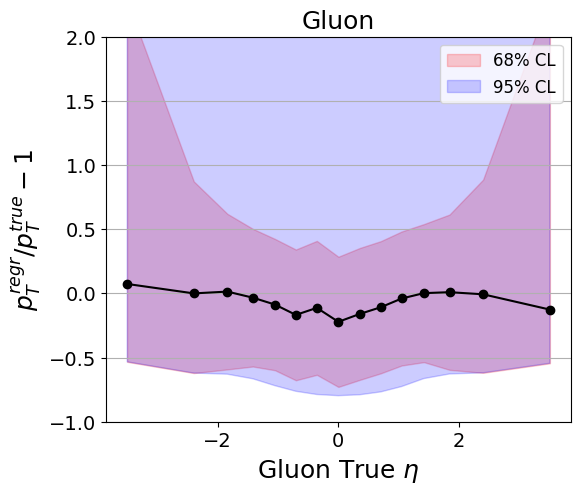

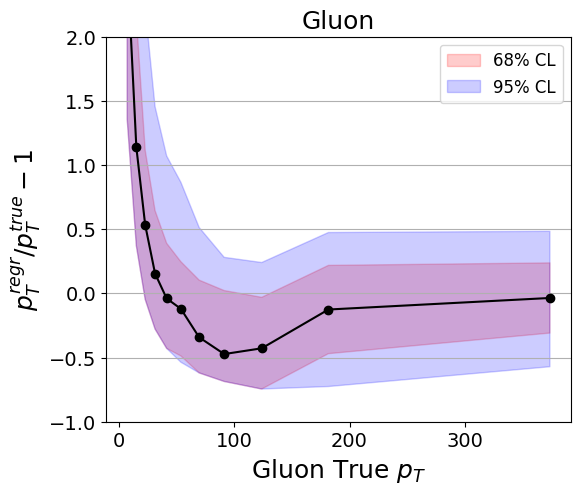

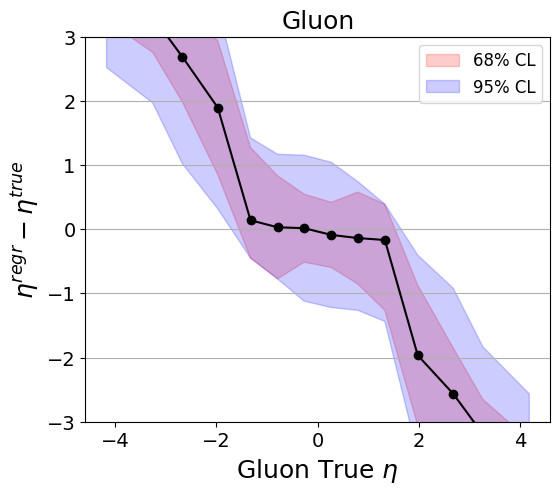

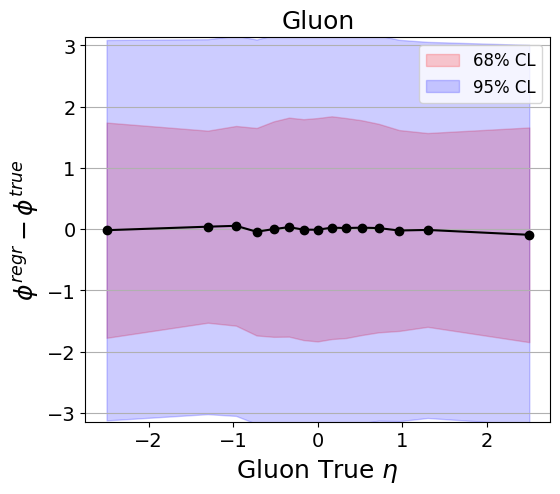

In [130]:
plot_diff_mode_quantile((df.delta_isr_pt/df.isr_pt).values, 
                        X=df.isr_eta.values,  
                        cat_var=df.isr_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.isr_eta.values, np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon')

plot_diff_mode_quantile((df.delta_isr_pt/df.isr_pt).values, 
                        X=df.isr_pt.values,  
                        cat_var=df.isr_pt.values, 
                        bins=np.quantile(df.isr_pt.values, np.linspace(0,1,12)),
                        xlabel='Gluon True $p_T$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon')

plot_diff_mode_quantile((df.delta_isr_eta).values, 
                        X=df.isr_eta.values,  
                        cat_var=df.isr_eta.values, 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(df.isr_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Gluon True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Gluon')

plot_diff_mode_quantile(df.delta_isr_phi.values, 
                        X=df.isr_eta.values,  
                        cat_var=df.isr_eta.values, 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(df.t2_eta.values, np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-pi,pi),
                    ylabel='$\phi^{regr} - \phi^{true} $', title='Gluon') 

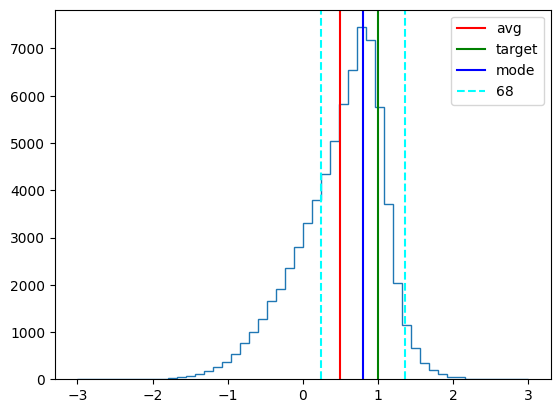

In [33]:
target = 1
mask = ((df.t1_eta>(target-0.1))&(df.t1_eta<(target+0.1)))

X = (df.t1_eta+ df.delta_t1_eta)[mask]
mode, left, right = get_central_smallest_interval(X.values, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(-3,3), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

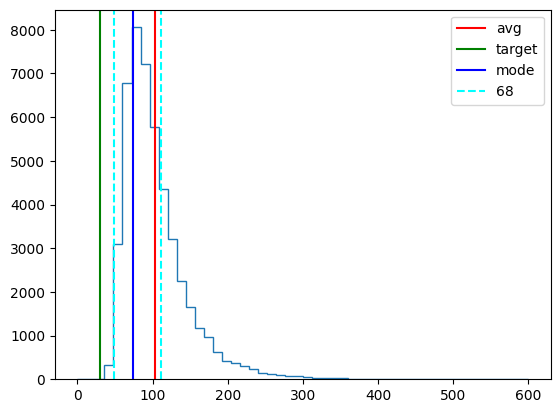

In [17]:
target = 30
mask = ((df.t2_pt>(target-10))&(df.t2_pt<(target+10)))

X = (df.t2_pt+ df.delta_t2_pt)[mask]
mode, left, right = get_central_smallest_interval(X.values, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(0,600), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

In [181]:
total["delta_x1"].shape

(2000,)

In [180]:
(total["x1"]+total["x2"]).shape

(1000000,)

In [190]:
plot_diff_mode_quantile(total["delta_x1"], 
                        X=total["x1"]+total["x2"],  
                        cat_var=total["x1"]+total["x2"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile((total["x1"]+total["x2"]), np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon')

KeyError: 'x1'

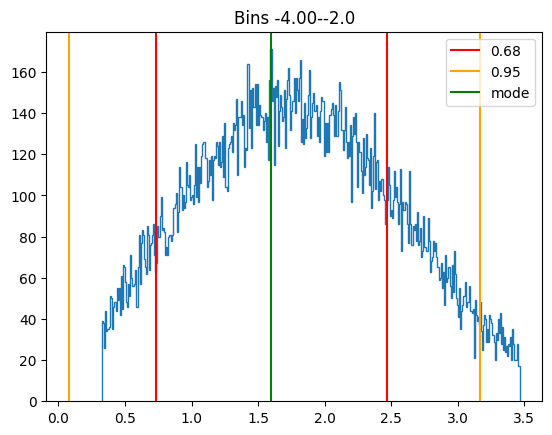

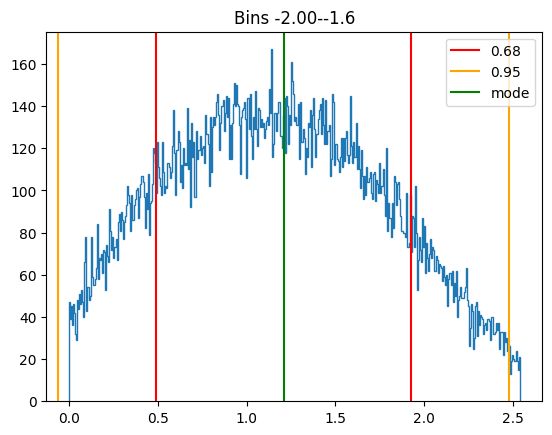

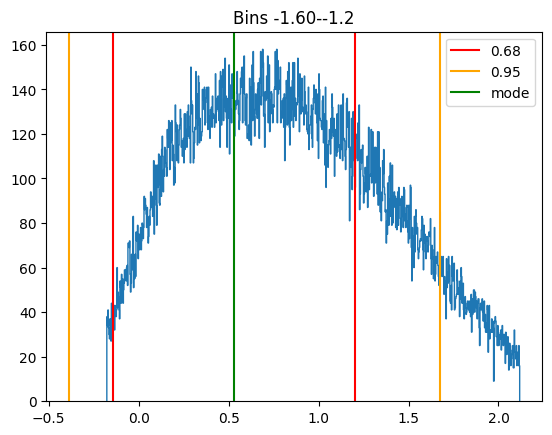

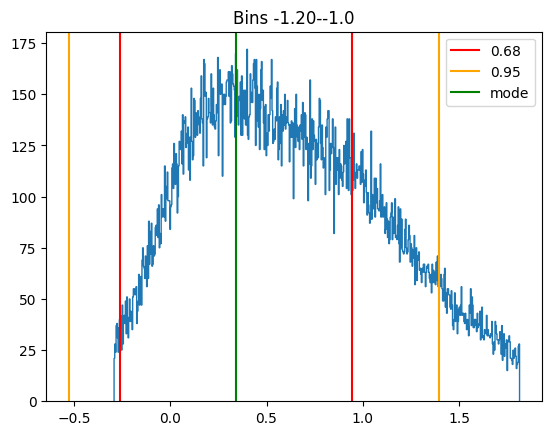

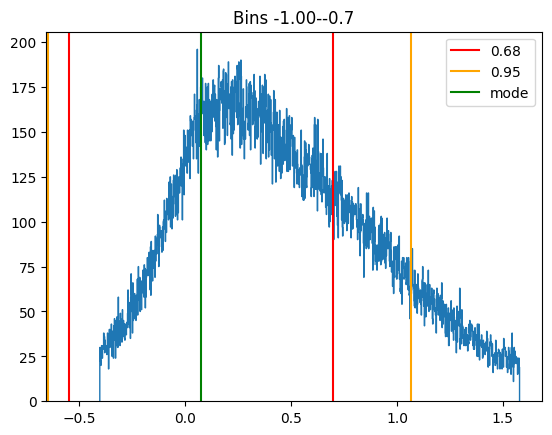

...

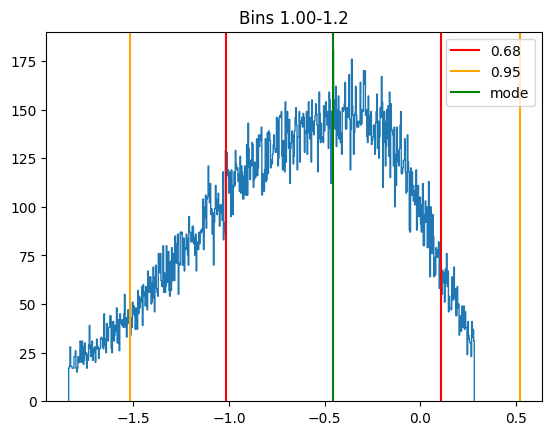

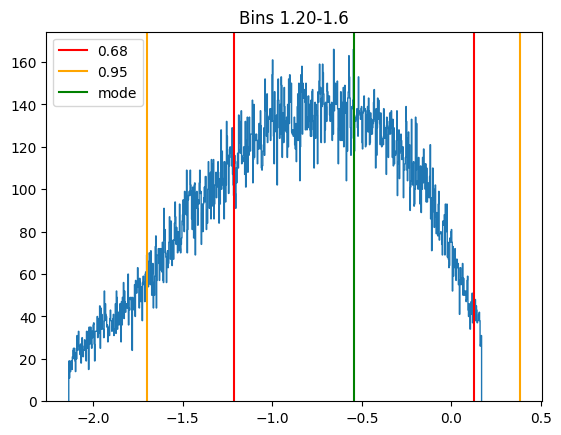

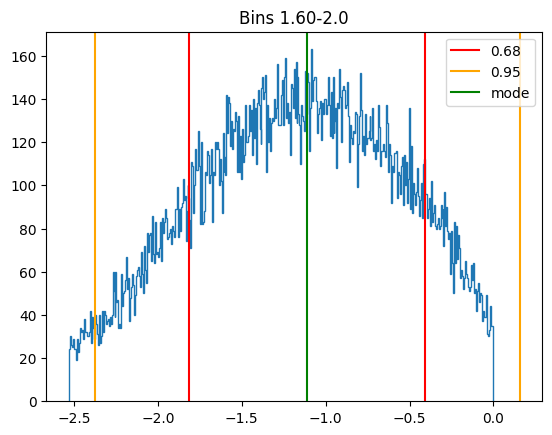

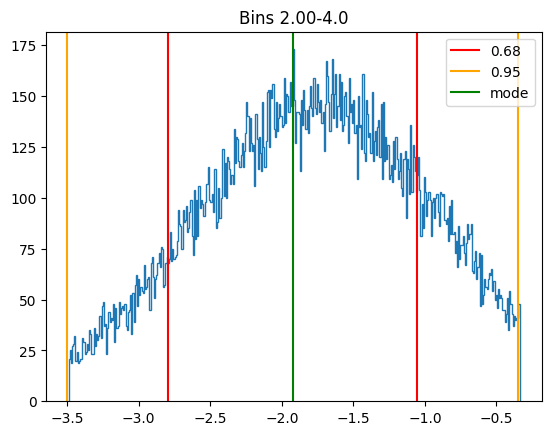

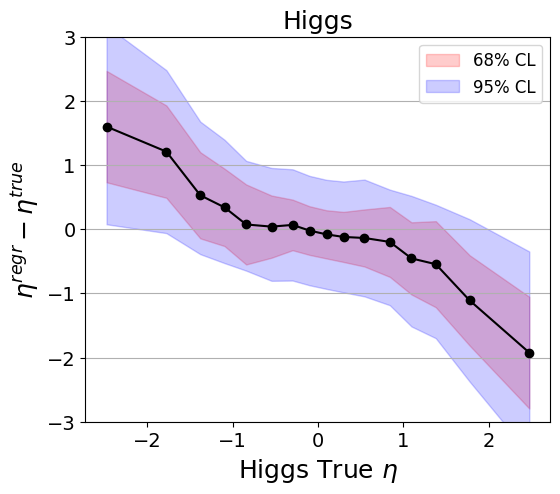

In [16]:
plot_diff_mode_quantile((df.delta_H_eta).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        bins=[-4.,-2.,-1.6, -1.2, -1.0, 
                               -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                               1., 1.2, 1.6, 2.,4.], nbins_mode =50,
                        #bins=np.quantile(df.H_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs', 
                       debug=True)


In [36]:
cum = []
cum_t1 = []
xs = np.linspace(0, 3, 30)
for x in xs:
    cum.append(np.sum(df.H_eta.abs()>x) / len(df.H_eta))
    cum_t1.append(np.sum(df.t1_eta.abs()>x) / len(df.t1_eta))

(array([5.0000e+00, 1.0000e+00, 1.0000e+01, 1.9000e+01, 2.0000e+01,
        2.8000e+01, 5.2000e+01, 6.9000e+01, 7.1000e+01, 9.3000e+01,
        1.3300e+02, 1.8600e+02, 2.2900e+02, 3.1900e+02, 4.0300e+02,
        5.1500e+02, 6.4600e+02, 7.9100e+02, 1.0280e+03, 1.3200e+03,
        1.4970e+03, 1.9510e+03, 2.3930e+03, 2.9090e+03, 3.5600e+03,
        4.3160e+03, 5.1080e+03, 6.1290e+03, 7.3580e+03, 8.5560e+03,
        1.0201e+04, 1.1785e+04, 1.3698e+04, 1.5716e+04, 1.8224e+04,
        2.0770e+04, 2.3243e+04, 2.6446e+04, 2.9442e+04, 3.2631e+04,
        3.6462e+04, 3.9604e+04, 4.2937e+04, 4.6908e+04, 5.0045e+04,
        5.3263e+04, 5.5509e+04, 5.7551e+04, 5.9285e+04, 5.9863e+04,
        5.9887e+04, 5.9472e+04, 5.7518e+04, 5.5672e+04, 5.2865e+04,
        5.0029e+04, 4.6884e+04, 4.3006e+04, 3.9349e+04, 3.5901e+04,
        3.2307e+04, 2.9220e+04, 2.5872e+04, 2.3145e+04, 2.0303e+04,
        1.7682e+04, 1.5413e+04, 1.3270e+04, 1.1415e+04, 9.7620e+03,
        8.2800e+03, 7.1620e+03, 5.9840e+03, 4.87

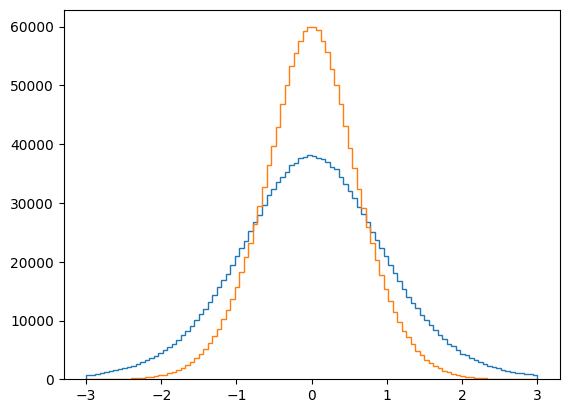

In [49]:
plt.hist(df.H_eta, bins=100, range=(-3,3), histtype="step")
plt.hist(df.H_eta+df.delta_H_eta, bins=100, range=(-3,3), histtype="step")

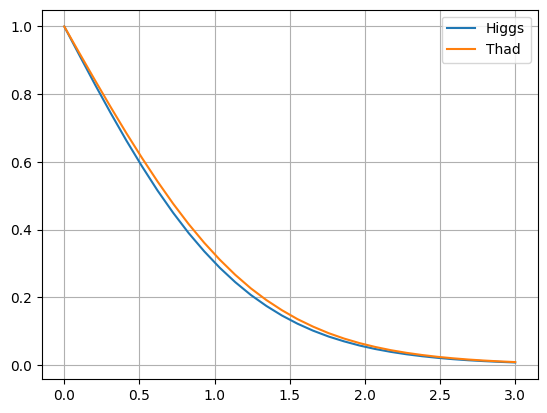

In [39]:
plt.plot(xs, cum, label="Higgs")
plt.plot(xs, cum_t1 , label="Thad")
plt.grid()
plt.legend()

In [161]:
np.quantiles(df.H_eta.abs()

0          0.459183
1          0.134169
2          0.459139
3          0.322623
4          0.804271
             ...   
1499995    1.840345
1499996    0.276695
1499997    0.946906
1499998    0.163123
1499999    1.957651
Name: H_eta, Length: 1500000, dtype: float64

# Evaluate the difference between the regressed value and the avg sample